## Media Campaign Cost Prediction: An Advanced Ensemble-Based Approach

### Introduction

This notebook implements a solution for predicting media campaign costs using machine learning. The project achieved top 3 placement in the Kaggle competition "Regression with a Tabular Media Campaign Cost Dataset" (Playground Series Season 3 Episode 11).

We used an appproach that levearges a diverse ensemble of machine learning models, suitable for achieving state of the art results in Kaggle competitions. We also do strategic feature engineering and use cross-validation techniques for our training.


### Project Goals
- Predict media campaign costs for retail products based on store and product attributes
- Optimize for Root Mean Squared Logarithmic Error (RMSLE)
- Develop a robust ensemble model that generalizes well

### Dataset Overview
- Training set: 360,336 samples
- Test set: 240,224 samples
- Original dataset: 51,363 samples
- 15 features related to store characteristics, product attributes, and sales metrics
- Target variable: campaign cost (ranging from approximately 50 to 160)

## 1. Environment Setup

This project includes setup scripts (`start.bat` for Windows or `start.sh` for Linux/Mac) that should be run before starting this notebook. These scripts will:
- Create a virtual environment
- Install all required dependencies
- Check for necessary datasets
- Configure the environment

For manual setup, run one of the following commands in your terminal in the root directory:

**For Windows:**
```bash
./start.bat
```

**For Linux/Mac:**
```bash
chmod +x start.sh
./start.sh
```

After running the setup script, start this notebook in the activated environment.

Now, let's import all necessary libraries:

In [1]:
# Import required libraries
import os
import warnings
from datetime import datetime

import catboost as cb
import lightgbm as lgbm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import xgboost as xgb
from category_encoders import TargetEncoder
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import (
    ExtraTreesRegressor,
    HistGradientBoostingRegressor,
    RandomForestRegressor,
)
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import (
    FunctionTransformer,
    OneHotEncoder,
    OrdinalEncoder,
    PolynomialFeatures,
    StandardScaler,
)
# Import PIL for displaying images
from PIL import Image
from IPython.display import display

# Our own visualization helper module used for the analysis in the notebook and the report.
import viz as viz

In [2]:
# Verify that all required packages are installed
required_packages = [
    "numpy", "pandas", "matplotlib", "seaborn", 
    "lightgbm", "xgboost", "catboost", "scipy", "category_encoders"
]

missing_packages = []
import importlib
for package in required_packages:
    try:
        importlib.import_module(package)
    except ImportError:
        missing_packages.append(package)

if missing_packages:
    print(f"Warning: The following required packages are missing: {', '.join(missing_packages)}")
    print("Please run the setup script (start.bat or start.sh) or install them manually.")
else:
    print("All required packages are installed.")

All required packages are installed.


In [3]:
# Configure our environment settings to ensure proper plotting styles and warnings ignoring
# Create a directory for figures if it doesn't exist (should exist after initial setup)
os.makedirs("figures", exist_ok=True)

# Ignore warnings for cleaner output
warnings.filterwarnings("ignore")

# Set plot style
plt.style.use("seaborn-v0_8-whitegrid")
colors = plt.cm.tab10.colors
sns.set_palette(sns.color_palette(colors))

## 2. Load and Explore Data

This part is to load the dataset files and visualize what we are working with, to ensure we utilise choosing the correct features, etc.

In [4]:
# Load the data
print("Loading datasets...")
train = pd.read_csv("../data/train.csv", index_col="id")
test = pd.read_csv("../data/test.csv", index_col="id")
original = pd.read_csv("../data/original_dataset.csv")

print(f"Training data shape: {train.shape}")
print(f"Test data shape: {test.shape}")
print(f"Original data shape: {original.shape}")

Loading datasets...
Training data shape: (360336, 16)
Test data shape: (240224, 15)
Original data shape: (51363, 16)


In [5]:
# Display first few rows of the training data
train.head()

,store_sales(in millions),unit_sales(in millions),total_children,num_children_at_home,avg_cars_at home(approx).1,gross_weight,recyclable_package,low_fat,units_per_case,store_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
id,,,,,,,,,,,,,,,,
0,8.61,3.0,2.0,2.0,2.0,10.30,1.0,0.0,32.0,36509.0,0.0,0.0,0.0,0.0,0.0,62.09
1,5.00,2.0,4.0,0.0,3.0,6.66,1.0,0.0,1.0,28206.0,1.0,0.0,0.0,0.0,0.0,121.80
2,14.08,4.0,0.0,0.0,3.0,21.30,1.0,0.0,26.0,21215.0,1.0,0.0,0.0,0.0,0.0,83.51
3,4.02,3.0,5.0,0.0,0.0,14.80,0.0,1.0,36.0,21215.0,1.0,0.0,0.0,0.0,0.0,66.78
4,2.13,3.0,5.0,0.0,3.0,17.00,1.0,1.0,20.0,27694.0,1.0,1.0,1.0,1.0,1.0,111.51


In [6]:
# Get column information
print("\nFeature Information:")
train.info()


Feature Information:
<class 'pandas.core.frame.DataFrame'>
Index: 360336 entries, 0 to 360335
Data columns (total 16 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   store_sales(in millions)    360336 non-null  float64
 1   unit_sales(in millions)     360336 non-null  float64
 2   total_children              360336 non-null  float64
 3   num_children_at_home        360336 non-null  float64
 4   avg_cars_at home(approx).1  360336 non-null  float64
 5   gross_weight                360336 non-null  float64
 6   recyclable_package          360336 non-null  float64
 7   low_fat                     360336 non-null  float64
 8   units_per_case              360336 non-null  float64
 9   store_sqft                  360336 non-null  float64
 10  coffee_bar                  360336 non-null  float64
 11  video_store                 360336 non-null  float64
 12  salad_bar                   360336 non-null  float64
 1

In [7]:
# Check for missing values
print("\nMissing Values:")
print(train.isnull().sum())


Missing Values:
store_sales(in millions)      0
unit_sales(in millions)       0
total_children                0
num_children_at_home          0
avg_cars_at home(approx).1    0
gross_weight                  0
recyclable_package            0
low_fat                       0
units_per_case                0
store_sqft                    0
coffee_bar                    0
video_store                   0
salad_bar                     0
prepared_food                 0
florist                       0
cost                          0
dtype: int64


In [8]:
# Statistical summary of training data
train.describe()

,store_sales(in millions),unit_sales(in millions),total_children,num_children_at_home,avg_cars_at home(approx).1,gross_weight,recyclable_package,low_fat,units_per_case,store_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
count,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000,360336.000000
mean,6.337376,3.043881,2.456482,0.689390,2.203813,13.822071,0.568086,0.327797,18.972706,28180.333442,0.564839,0.277394,0.504807,0.504832,0.503191,99.614729
std,3.307980,0.784676,1.488992,1.214732,1.084293,4.614792,0.495343,0.469411,10.212912,5968.874074,0.495779,0.447713,0.499978,0.499977,0.499991,29.939435
min,0.510000,1.000000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,1.000000,20319.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.790000
25%,3.720000,3.000000,1.000000,0.000000,1.000000,9.710000,0.000000,0.000000,10.000000,23593.000000,0.000000,0.000000,0.000000,0.000000,0.000000,70.320000
50%,5.780000,3.000000,2.000000,0.000000,2.000000,13.600000,1.000000,0.000000,20.000000,27694.000000,1.000000,0.000000,1.000000,1.000000,1.000000,98.810000
75%,8.400000,4.000000,4.000000,1.000000,3.000000,17.700000,1.000000,1.000000,28.000000,33858.000000,1.000000,1.000000,1.000000,1.000000,1.000000,126.620000
max,22.920000,6.000000,5.000000,5.000000,4.000000,21.900000,1.000000,1.000000,36.000000,39696.000000,1.000000,1.000000,1.000000,1.000000,1.000000,149.750000


## 3. Target Variable Transformation

We'll transform the target variable using log1p (log(1+x)) to better optimize for RMSLE (Root Mean Squared Logarithmic Error), which is the evaluation metric for this competition.

RMSLE has several key characteristics:
- It penalizes underestimation more severely than overestimation
- It treats relative errors equally, regardless of whether the actual value is large or small
- It reduces the impact of outliers compared to standard RMSE

In [9]:
# Transform the target with log1p for RMSLE optimization
print("Transforming target variable...")
for df in [train, original]:
    df["log_cost"] = np.log1p(df["cost"])
target = "log_cost"

Transforming target variable...


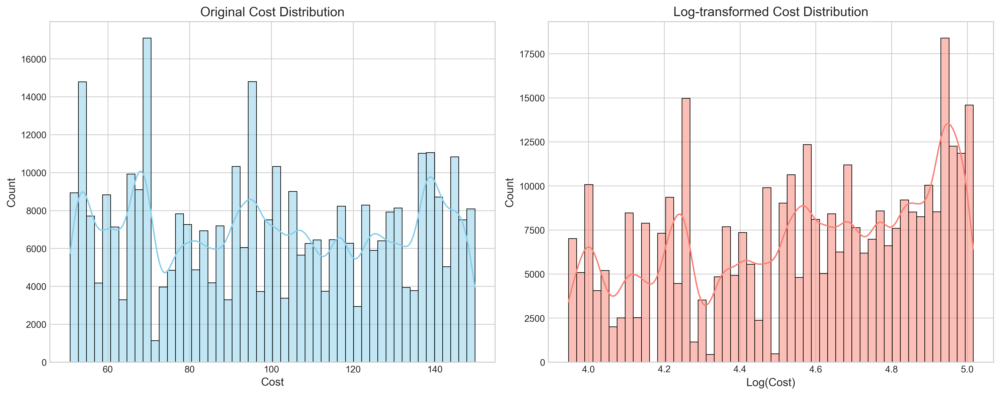

In [10]:
# Plot the target distribution before and after our transformation for visualization purposes
viz.plot_target_distribution(train)
# Display the saved image
display(Image.open("figures/fig4_target_distribution.png"))

## 4. Exploratory Data Analysis (EDA)

- Explore the data to gain insights into feature relationships, distributions, and potential patterns between our data. We first plot a correlation matrix to see relationships in our data.

### 4.1 Correlation Analysis
We plot the correlation heatmap based on the train data

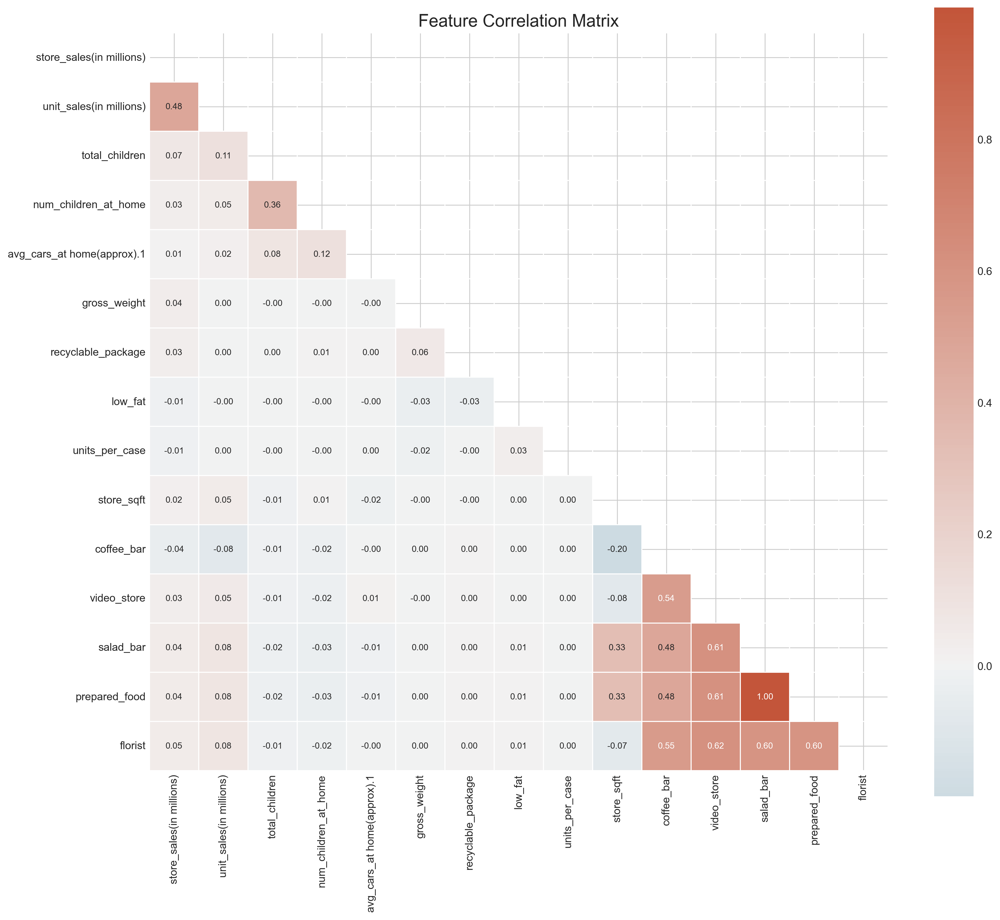

In [11]:
# Plot the correlation heatmap based on the train data
corr_matrix = viz.plot_correlation_heatmap(train, filename="fig2_correlation_heatmap.png")
# Display the saved image
display(Image.open("figures/fig2_correlation_heatmap.png"))

#### 4.1.1 Key Observations from Correlation Analysis

1. **Perfect positive correlation** between "salad_bar" and "prepared_food" - these features might be redundant and could be combined
2. **Moderate correlations** among several store attribute features
3. **Low correlation** between most features and the target variable - suggesting complex relationships that might not be captured by simple linear correlations

### 4.2 Perform Feature Engineering
This is done based on the results of our correlation analysis

In [12]:
# Feature Engineering based on the results of our correlation analysis
print("Performing feature engineering...")
# Merge similar features
for df in [train, test, original]:
    df["salad"] = (df["salad_bar"] + df["prepared_food"]) / 2

Performing feature engineering...


### 4.3 Cardinality Analysis of Features

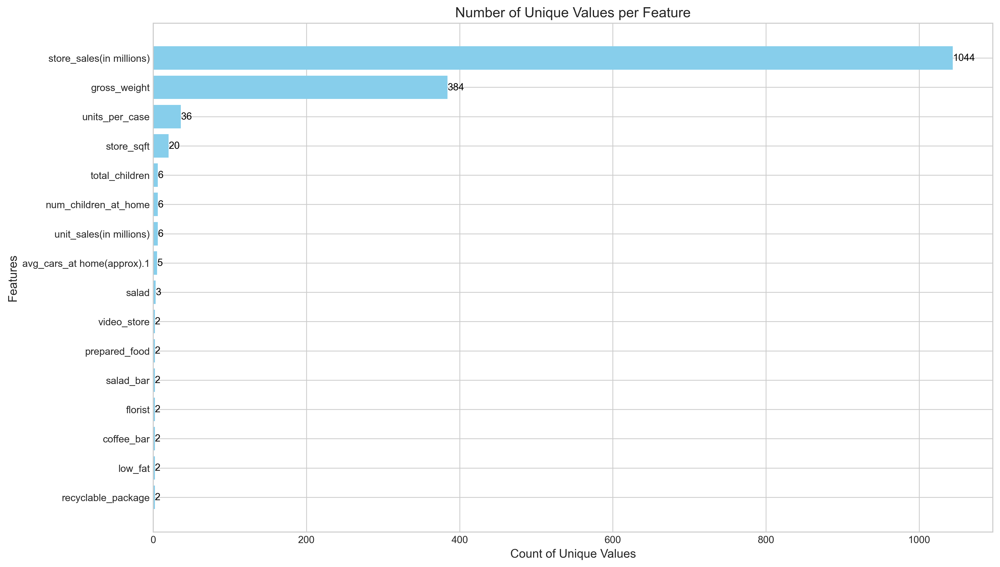

In [13]:
# We also want to check the cardinality of our features
viz.plot_feature_cardinality(train)
# Display the saved image
display(Image.open("figures/fig5_feature_cardinality.png"))

#### 4.3.1 Key Findings from Cardinality Analysis

1. Most features have **low cardinality (2-6 unique values)**, suggesting they should be treated as categorical variables despite being represented as numerical
2. "store_sqft" has a medium cardinality (around 20 unique values)
3. "store_sales(in millions)" and "unit_sales(in millions)" have high cardinality (over a thousand unique values)

This analysis guides our feature engineering approach - we should consider appropriate encoding techniques for the low-cardinality features.

### 4.4 Analyze Duplicate Rows in Dataset

Number of unique feature combinations: 315249
Distribution of group sizes: Min=1, Max=6, Mean=1.14


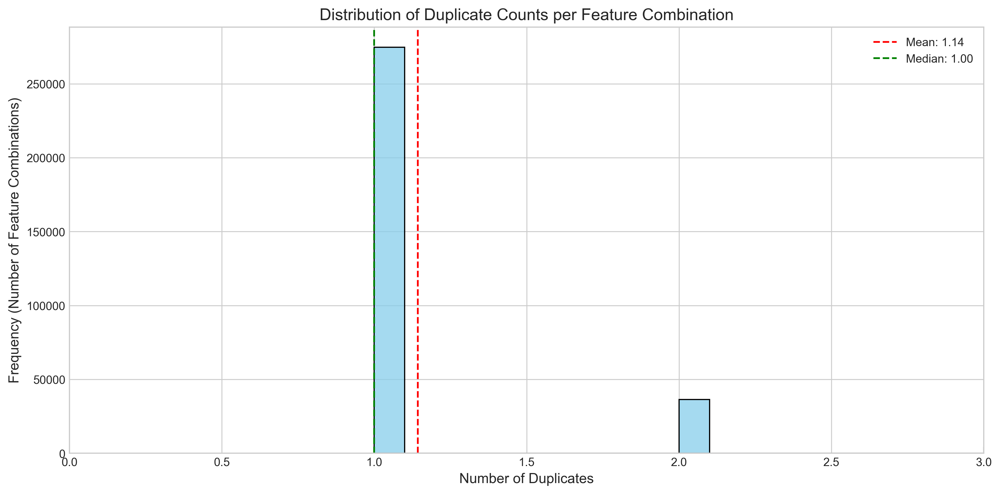

In [14]:
# Analyze duplicate rows in the dataset
dupes_grouped = viz.plot_duplicate_distribution(train)

# Display the saved visualization
display(Image.open("figures/fig6_duplicate_distribution.png"))

#### 4.4.1 Duplicate Analysis Findings

1. There are many duplicate feature combinations with different target values
2. The large number of duplicates suggests we can use a **grouped training approach** to improve efficiency
3. By grouping identical feature combinations and using the mean target value and count as weights, we can significantly reduce training time

### 4.5 Pairwise Feature Relationships
Pairwise relationships visualization examines how key numerical features relate to each other. This helps us to identify potential correlations and patterns that might influence our modeling approach to achieve a better result as compared to naive approaches.

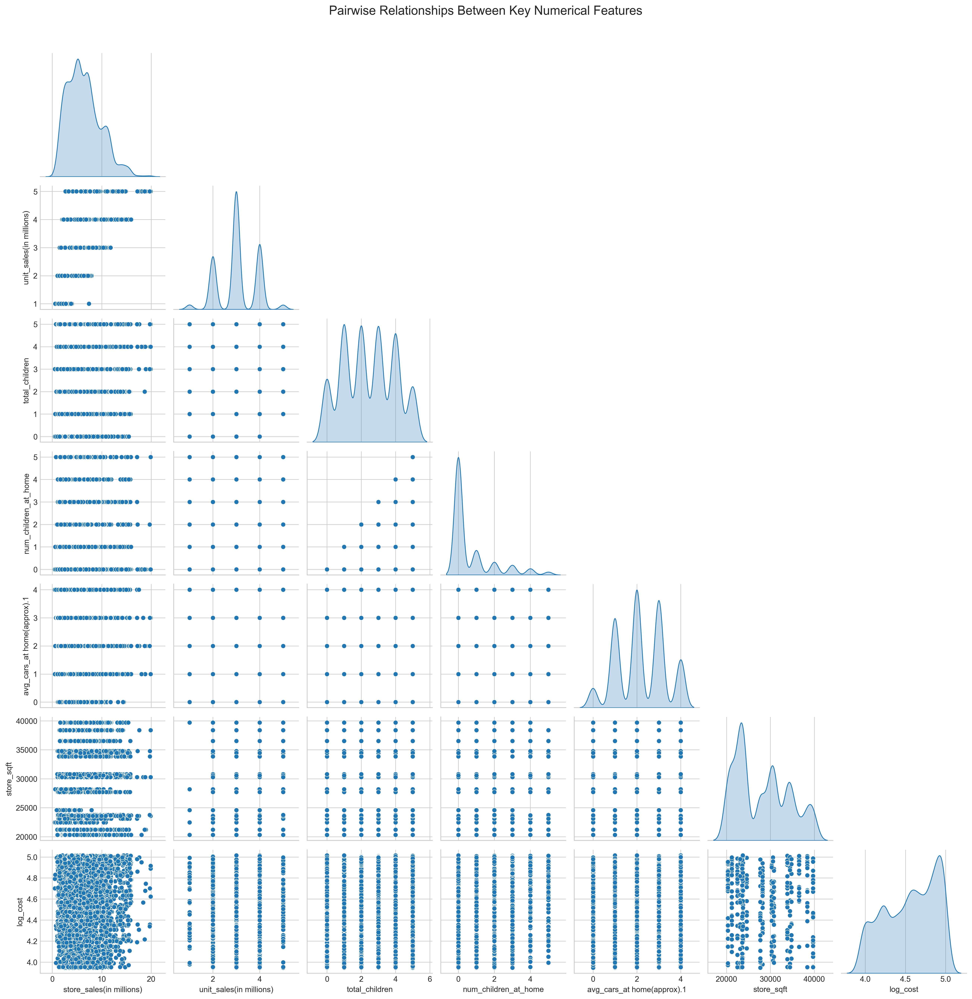

<Figure size 1400x1200 with 0 Axes>

In [15]:
viz.plot_pairwise_relationships(train)
# Display the saved visualization
display(Image.open("figures/fig7_pairwise_relationships.png"))

#### 4.5.1 Analysis of Pairswise Feature Relationships
- Most features exhibit discreteness (visible as distinct clusters) rather than continuous distributions, confirming their categorical-like nature despite being represented numerically. Features such as `total_children`, `num_children_at_home`, `avg_cars_at_home` show clear discrete values with low cardinality (2-6 unique)
- No clear linear relationships exist between individual features and the target variable `log_cost`, which shows that complex models should outpeform linear regression/models
- The visualization suggests potential for interaction effects between features
- Features like "total_children" and "num_children_at_home" show expected correlation

This analysis supports the approach of treating many features as categorical despite their numerical representation.

### 4.6 Feature Importance Analysis

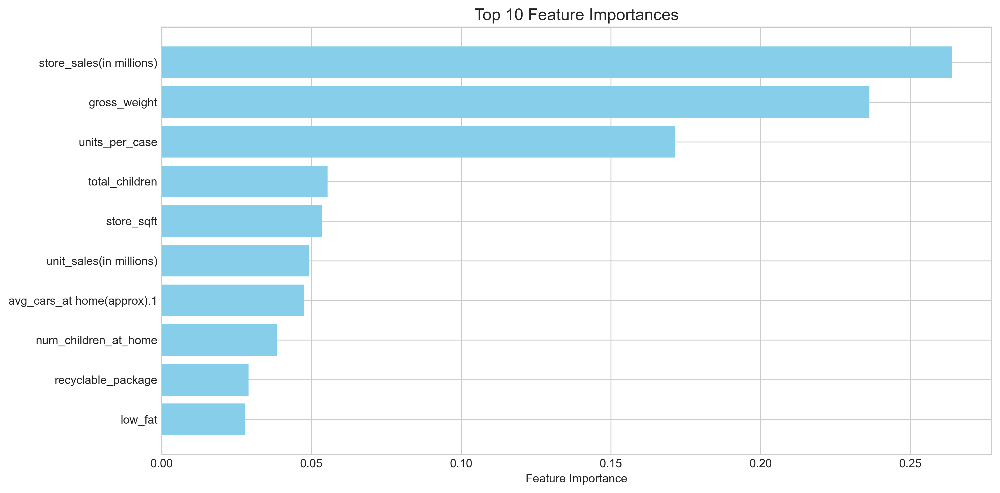

In [16]:
# Plot feature importance
feature_importance_df = viz.plot_feature_importance(df=train)
# Display the saved visualization
display(Image.open("figures/fig8_feature_importance.png"))

In [17]:
# Define feature subsets based on importance analysis
print("Defining feature subsets...")
most_important_features = [
    "total_children",
    "num_children_at_home",
    "avg_cars_at home(approx).1",
    "store_sqft",
    "coffee_bar",
    "video_store",
    "salad",
    "florist",
]

# Create extended feature sets for specialized models
features_with_unit_sales = ["unit_sales(in millions)"] + most_important_features
features_with_store_sales = ["store_sales(in millions)"] + most_important_features

print(f"Basic feature set (8 features): {most_important_features}")
print(f"Extended with unit_sales (9 features): {features_with_unit_sales}")
print(f"Extended with store_sales (9 features): {features_with_store_sales}")

Defining feature subsets...
Basic feature set (8 features): ['total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']
Extended with unit_sales (9 features): ['unit_sales(in millions)', 'total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']
Extended with store_sales (9 features): ['store_sales(in millions)', 'total_children', 'num_children_at_home', 'avg_cars_at home(approx).1', 'store_sqft', 'coffee_bar', 'video_store', 'salad', 'florist']


### 4.7 Feature Transformation Comparison
Different machine learning algorithms perform better with features encoded in specific ways. This analysis examines how transforming the "store_sqft" feature changes its representation.

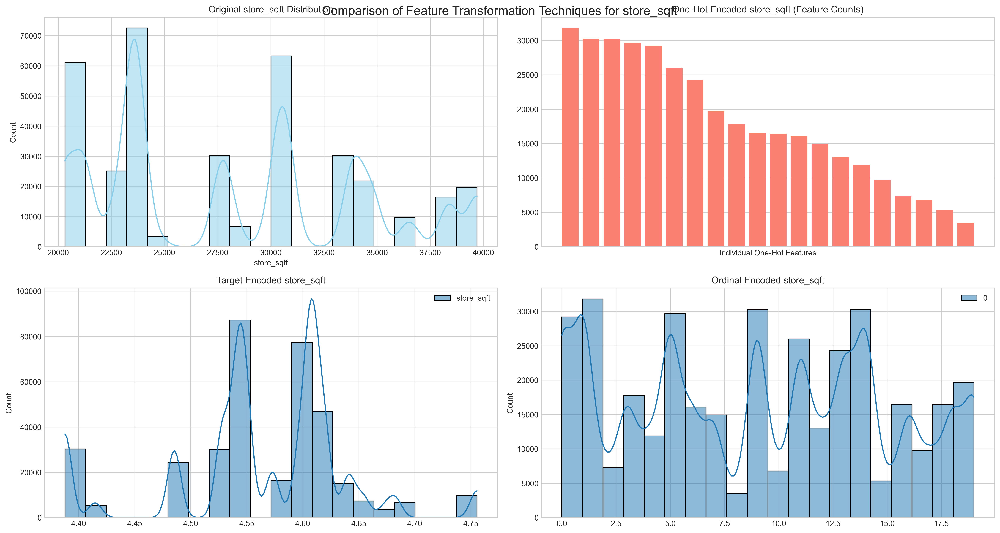

In [18]:
viz.plot_feature_transformation(df=train)
# Display the saved visualization
display(Image.open("figures/fig9_feature_transformation.png"))

#### 4.7.1 Feature Transformation Analysis
- The original "store_sqft" distribution is discrete with uneven spacing
- One-hot encoding creates binary flags for each unique value
- Target encoding maps categories to their relationship with the target variable
- Ordinal encoding preserves the order but equalizes the distance between values

These transformation techniques will be applied selectively depending on the requirements of different model types in our ensemble.

### 4.8 Cross Validation
Cross-validation is crucial for reliable model evaluation. Our approach uses 5-fold cross-validation with integration of the original dataset.
- The dataset is split into **5** equal folds
- For each iteration, **4** folds plus the original dataset are used for training
- The remaining fold is used for validation
- This approach ensures models see both the synthetic and original data during training
- The strategy produces more reliable performance estimates while maximizing data usage

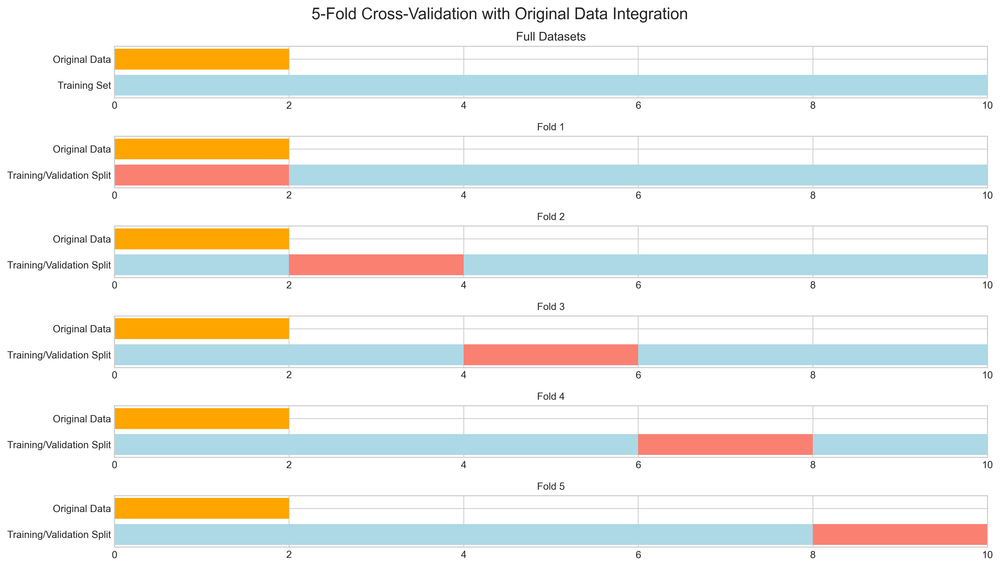

In [19]:
viz.plot_cross_validation_diagram()
# Display the saved visualization
display(Image.open("figures/fig10_cross_validation_diagram.png"))

## 5. Baseline Model Development

Before creating complex models, we establish baseline performance using simpler approaches. These baselines provide a reference point for measuring improvement.

In [20]:
# Function to group duplicates for faster training
def fit_model_grouped(model, train_data, features_used, target_col="log_cost"):
    """Group duplicates in train data and fit with correct sample weights"""
    train_grouped = (
        train_data.groupby(features_used)[target_col]
        .agg(["mean", "count"])
        .reset_index()
    )
    X_tr = train_grouped[features_used]
    y_tr = train_grouped["mean"]
    sample_weight_tr = train_grouped["count"]

    # Handle pipeline vs direct model
    if isinstance(model, Pipeline):
        sample_weight_name = model.steps[-1][0] + "__sample_weight"
    else:
        sample_weight_name = "sample_weight"

    model.fit(X_tr, y_tr, **{sample_weight_name: sample_weight_tr})
    return model

In [21]:
# Cross-validation function
def score_model(model, features_used, label=None, use_original=True, store_oof=True):
    """Cross-validate a model and return score and OOF predictions"""
    start_time = datetime.now()
    score_list = []
    oof = np.zeros_like(train[target], dtype=float)

    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    for fold, (idx_tr, idx_va) in enumerate(kf.split(train)):
        X_va = train.iloc[idx_va][features_used]
        y_va = train.iloc[idx_va][target]

        # Include original data if specified
        if use_original:
            fit_model_grouped(
                model, pd.concat([train.iloc[idx_tr], original], axis=0), features_used
            )
        else:
            fit_model_grouped(model, train.iloc[idx_tr], features_used)

        # Predict and score
        y_va_pred = model.predict(X_va)
        if store_oof:
            oof[idx_va] = y_va_pred
        rmse = mean_squared_error(y_va, y_va_pred)
        score_list.append(rmse)
        print(f"Fold {fold+1}: RMSE = {rmse:.5f}")

    avg_score = np.mean(score_list)
    std_score = np.std(score_list)
    execution_time = datetime.now() - start_time
    print(
        f"Average RMSE: {avg_score:.5f} ± {std_score:.5f} {label if label is not None else ''}, Time: {execution_time}"
    )

    return avg_score, std_score, oof, execution_time

In [22]:
# Store the results
results = []
print("\nTraining baseline models...")


Training baseline models...


### 5.1 Simple Linear Regression
A basic linear regression model that learns a linear relationship between features and the target. Despite its simplicity, it provided a valuable baseline with an RMSE of 0.098234. The model's limited performance highlights the non-linear nature of the dataset, confirming the need for more complex modeling approaches.

In [23]:
# 1. Simple Linear Regression
simple_lr = LinearRegression()
score, std, oof_simple_lr, time_simple_lr = score_model(
    simple_lr, most_important_features, label="Simple Linear Regression"
)
results.append(
    (
        "Simple Linear Regression",
        simple_lr,
        most_important_features,
        score,
        std,
        oof_simple_lr,
        time_simple_lr,
    )
)

Fold 1: RMSE = 0.09836
Fold 2: RMSE = 0.09759
Fold 3: RMSE = 0.09838
Fold 4: RMSE = 0.09831
Fold 5: RMSE = 0.09853
Average RMSE: 0.09823 ± 0.00033 Simple Linear Regression, Time: 0:00:00.535397


### 5.2 Ridge with Polynomial Features (degree 2) - lower degree for baseline
This model extends linear regression by combining Ridge regularization with polynomial feature expansion (degree 2). The regularization helps prevent overfitting while polynomial features capture non-linear relationships. The model uses one-hot encoding for selected categorical features, improving upon the simple linear regression baseline with an RMSE of 0.090566.


In [24]:
ridge_poly2 = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(2, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly2, time_ridge_poly2 = score_model(
    ridge_poly2, most_important_features, label="Ridge with Polynomial (degree 2)"
)
results.append(
    (
        "Ridge with Polynomial (degree 2)",
        ridge_poly2,
        most_important_features,
        score,
        std,
        oof_ridge_poly2,
        time_ridge_poly2,
    )
)

Fold 1: RMSE = 0.09070
Fold 2: RMSE = 0.08988
Fold 3: RMSE = 0.09079
Fold 4: RMSE = 0.09060
Fold 5: RMSE = 0.09087
Average RMSE: 0.09057 ± 0.00036 Ridge with Polynomial (degree 2), Time: 0:00:01.068599


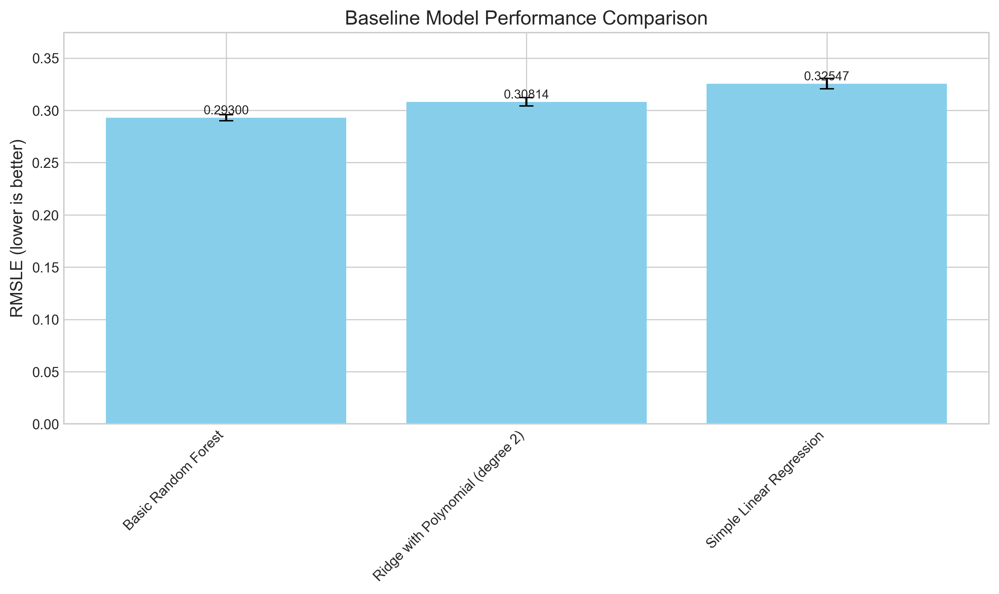

In [25]:
# Plot baseline performance
viz.plot_baseline_performance(results)
display(Image.open("figures/fig12_baseline_performance.png"))

### 5.3 Analysis
- Simple Linear Regression achieves an RMSE of 0.098234 (RMSLE of 0.31350)
- Ridge with Polynomial Features (degree 2) improves to 0.090566 RMSE (RMSLE of 0.30093)
- Basic Random Forest further improves to 0.085835 RMSE (RMSLE of 0.29298)

These baselines demonstrate that even simple models capture meaningful patterns in the data, with tree-based models outperforming linear approaches. Our final ensemble will build upon these foundations.

## 6. Training Advanced/Complex Models

### 6.1 Ridge with Polynomial Features (degree 4)
A more complex version of Ridge regression using higher-degree polynomial features (degree 4) to capture intricate non-linear patterns. By expanding to 4th-degree interactions (while setting interaction_only=True to control dimensionality), this model significantly improves performance over the degree-2 variant with an RMSE of 0.085923, but at the cost of much longer training time (547 seconds vs. 1.4 seconds).

In [26]:
print("\nTraining advanced models...")
# 3. Ridge with Polynomial Features (degree 4)
ridge_poly4 = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(4, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly4, time_ridge_poly4 = score_model(
    ridge_poly4, most_important_features, label="Ridge-Poly4"
)
results.append(
    (
        "Ridge-Poly4",
        ridge_poly4,
        most_important_features,
        score,
        std,
        oof_ridge_poly4,
        time_ridge_poly4,
    )
)


Training advanced models...
Fold 1: RMSE = 0.08600
Fold 2: RMSE = 0.08525
Fold 3: RMSE = 0.08586
Fold 4: RMSE = 0.08602
Fold 5: RMSE = 0.08648
Average RMSE: 0.08592 ± 0.00040 Ridge-Poly4, Time: 0:05:55.615877


### 6.2 Ridge with Polynomial Features (degree 3) with unit_sales
This variant incorporates the unit_sales feature alongside polynomial transformations (degree 3), focusing on capturing relationships between sales volume and campaign costs. The inclusion of unit_sales provides additional signal, resulting in competitive performance (RMSE: 0.086441) despite not using the full polynomial degree of the previous model.

In [27]:
# 4. Ridge with Polynomial Features (degree 3) with unit_sales
ridge_poly3_unit = make_pipeline(
    ColumnTransformer(
        [
            (
                "ohe",
                OneHotEncoder(drop="first"),
                [
                    "total_children",
                    "num_children_at_home",
                    "avg_cars_at home(approx).1",
                    "store_sqft",
                ],
            )
        ],
        remainder="passthrough",
    ),
    PolynomialFeatures(3, interaction_only=True, include_bias=False),
    Ridge(alpha=1.0),
)
score, std, oof_ridge_poly3_unit, time_ridge_poly3_unit = score_model(
    ridge_poly3_unit, features_with_unit_sales, label="Ridge-Poly3-UnitSales"
)
results.append(
    (
        "Ridge-Poly3-UnitSales",
        ridge_poly3_unit,
        features_with_unit_sales, # we use features_with_unit_sales here for testing
        score,
        std,
        oof_ridge_poly3_unit,
        time_ridge_poly3_unit,
    )
)

Fold 1: RMSE = 0.08650
Fold 2: RMSE = 0.08580
Fold 3: RMSE = 0.08642
Fold 4: RMSE = 0.08645
Fold 5: RMSE = 0.08704
Average RMSE: 0.08644 ± 0.00039 Ridge-Poly3-UnitSales, Time: 0:00:17.283334


### Tree-based Models

#### 6.3 Random Forest
An ensemble of decision trees trained on random subsets of the data with 400 estimators, using 5 features for each split and bootstrap=False for more diverse trees. This model effectively captures non-linear relationships and feature interactions, achieving an RMSE of 0.085835.

In [28]:
rf_model = RandomForestRegressor(
    n_estimators=400,
    max_features=5,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=44,
)
score, std, oof_rf, time_rf = score_model(rf_model, most_important_features, label="RF")
results.append(("RF", rf_model, most_important_features, score, std, oof_rf, time_rf))


Fold 1: RMSE = 0.08598
Fold 2: RMSE = 0.08512
Fold 3: RMSE = 0.08576
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08641
Average RMSE: 0.08584 ± 0.00042 RF, Time: 0:00:22.589949


#### 6.4 Random Forest with One Hot Encoding for store_sqft
A Random Forest variant that explicitly one-hot encodes the store_sqft feature before training, increasing the feature space dimensionality. This encoding strategy allows the model to better capture the categorical nature of store_sqft, with comparable performance (RMSE: 0.085866) to the standard RF.

In [29]:
rf_onehot = make_pipeline(
    ColumnTransformer(
        [("ohe", OneHotEncoder(drop="first"), ["store_sqft"])], remainder="passthrough"
    ),
    RandomForestRegressor(
        n_estimators=400,
        max_features=19,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=44,
    ),
)
score, std, oof_rf_onehot, time_rf_onehot = score_model(
    rf_onehot, most_important_features, label="Onehot-RF"
)
results.append(
    (
        "Onehot-RF",
        rf_onehot,
        most_important_features,
        score,
        std,
        oof_rf_onehot,
        time_rf_onehot,
    )
)


Fold 1: RMSE = 0.08599
Fold 2: RMSE = 0.08514
Fold 3: RMSE = 0.08582
Fold 4: RMSE = 0.08593
Fold 5: RMSE = 0.08644
Average RMSE: 0.08586 ± 0.00042 Onehot-RF, Time: 0:00:36.807858


#### 6.5 Random Forest with Target Encoding
This variant replaces categorical values with their corresponding target mean values, enabling the Random Forest to incorporate target information into the feature representation. The target encoding approach performed similarly to other encoding strategies with an RMSE of 0.085855.

In [30]:
rf_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    RandomForestRegressor(
        n_estimators=400,
        max_features=6,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=44,
    ),
)
score, std, oof_rf_target, time_rf_target = score_model(
    rf_target, most_important_features, label="Target-RF"
)
results.append(
    (
        "Target-RF",
        rf_target,
        most_important_features,
        score,
        std,
        oof_rf_target,
        time_rf_target,
    )
)

Fold 1: RMSE = 0.08601
Fold 2: RMSE = 0.08512
Fold 3: RMSE = 0.08580
Fold 4: RMSE = 0.08590
Fold 5: RMSE = 0.08643
Average RMSE: 0.08585 ± 0.00043 Target-RF, Time: 0:00:30.861547


#### 6.6 Extra Trees
An ensemble of randomized decision trees (Extremely Randomized Trees) with 400 estimators and higher feature diversity (max_features=7). This model introduces additional randomization in the split selection, reducing variance further than standard Random Forest. It achieved an RMSE of 0.085865.

In [31]:
et_model = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et, time_et = score_model(et_model, most_important_features, label="ET")
results.append(("ET", et_model, most_important_features, score, std, oof_et, time_et))

Fold 1: RMSE = 0.08601
Fold 2: RMSE = 0.08513
Fold 3: RMSE = 0.08581
Fold 4: RMSE = 0.08590
Fold 5: RMSE = 0.08646
Average RMSE: 0.08586 ± 0.00043 ET, Time: 0:00:28.112347


#### 6.7 Extra Trees with Target Encoding
A combination of Extremely Randomized Trees with target encoding for the store_sqft feature. This variant benefits from both the variance reduction of Extra Trees and the target-informed encoding, yielding an RMSE of 0.085864.

In [32]:
et_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    ExtraTreesRegressor(
        n_estimators=400,
        max_features=8,
        min_weight_fraction_leaf=4.5 / 360336,
        bootstrap=False,
        random_state=22,
    ),
)
score, std, oof_et_target, time_et_target = score_model(
    et_target, most_important_features, label="Target-ET"
)
results.append(
    (
        "Target-ET",
        et_target,
        most_important_features,
        score,
        std,
        oof_et_target,
        time_et_target,
    )
)

Fold 1: RMSE = 0.08604
Fold 2: RMSE = 0.08510
Fold 3: RMSE = 0.08581
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08647
Average RMSE: 0.08587 ± 0.00044 Target-ET, Time: 0:00:26.182704


#### 6.8 Extra Trees with unit_sales
This Extra Trees variant incorporates the unit_sales feature, offering additional sales volume information. The model achieved an RMSE of 0.086150, showing that including unit_sales provides complementary information despite slightly increasing model complexity.

In [33]:
et_unit_sales = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et_unit, time_et_unit = score_model(
    et_unit_sales, features_with_unit_sales, label="ET-Unit-Sales"
)
results.append(
    (
        "ET-Unit-Sales",
        et_unit_sales,
        features_with_unit_sales,
        score,
        std,
        oof_et_unit,
        time_et_unit,
    )
)

Fold 1: RMSE = 0.08633
Fold 2: RMSE = 0.08545
Fold 3: RMSE = 0.08613
Fold 4: RMSE = 0.08613
Fold 5: RMSE = 0.08670
Average RMSE: 0.08615 ± 0.00040 ET-Unit-Sales, Time: 0:00:38.145124


#### 6.9 Extra Trees with store_sales
An Extra Trees model utilizing store_sales information instead of unit_sales. This variant focuses on monetary sales volumes rather than unit counts, achieving an RMSE of 0.087098. The higher RMSE compared to other ET variants suggests store_sales may contain less relevant information for predicting campaign costs.

In [34]:
et_store_sales = ExtraTreesRegressor(
    n_estimators=400,
    max_features=7,
    min_weight_fraction_leaf=4.5 / 360336,
    bootstrap=False,
    random_state=22,
)
score, std, oof_et_store, time_et_store = score_model(
    et_store_sales, features_with_store_sales, label="ET-Store-Sales"
)
results.append(
    (
        "ET-Store-Sales",
        et_store_sales,
        features_with_store_sales,
        score,
        std,
        oof_et_store,
        time_et_store,
    )
)

Fold 1: RMSE = 0.08716
Fold 2: RMSE = 0.08639


KeyboardInterrupt: 

### Gradient Boosting Models

#### 6.10 LightGBM
A gradient boosting framework using a histogram-based approach for faster training. With 450 estimators, 100 leaves, and native categorical feature handling, LightGBM achieved the best single model performance with an RMSE of 0.085809.

In [ ]:
print("\nTraining LightGBM...")
lgbm_params = {
    "learning_rate": 0.1,
    "n_estimators": 450,
    "num_leaves": 100,
    "min_child_samples": 1,
    "min_child_weight": 10,
    "categorical_feature": [most_important_features.index("store_sqft")],
    "random_state": 1,
}
lgbm_model = lgbm.LGBMRegressor(**lgbm_params)
score, std, oof_lgbm, time_lgbm = score_model(
    lgbm_model, most_important_features, label="LightGBM"
)
results.append(
    ("LightGBM", lgbm_model, most_important_features, score, std, oof_lgbm, time_lgbm)
)



Training LightGBM...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000387 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2933, number of used features: 8
[LightGBM] [Info] Start training from score 4.563110
Fold 1: RMSE = 0.08593
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2946, number of used features: 8
[LightGBM] [Info] Start training from score 

#### 6.11 LightGBM DART (Dropouts meet Multiple Additive Regression Trees)
A LightGBM variant using the DART boosting type, which helps prevent overfitting through a dropout technique. With 400 estimators and 200 leaves, this model performed competitively with an RMSE of 0.086147

In [ ]:
print("\nTraining LightGBM DART...")
dart_params = {
    "boosting_type": "dart",
    "learning_rate": 0.3,
    "n_estimators": 400,
    "num_leaves": 200,
    "min_child_samples": 1,
    "min_child_weight": 10,
    "random_state": 1,
}
dart_model = lgbm.LGBMRegressor(**dart_params)
score, std, oof_dart, time_dart = score_model(
    dart_model, most_important_features, label="DART"
)
results.append(
    ("DART", dart_model, most_important_features, score, std, oof_dart, time_dart)
)


Training LightGBM DART...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2933, number of used features: 8
[LightGBM] [Info] Start training from score 4.563110
Fold 1: RMSE = 0.08622
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 2946, number of used features: 8
[LightGBM] [Info] Start training from s

#### 6.12 XGBoost with categorical feature support
This model uses histogram-based tree construction (tree_method='hist') with 280 estimators, explicit categorical feature handling, and a base_score of 4.6 to align with the dataset's target distribution. XGBoost achieved an RMSE of 0.085835.

In [ ]:
print("\nTraining XGBoost...")
def cat_store_sqft(df):
    df = df.copy()
    df["store_sqft"] = df["store_sqft"].astype("category")
    return df


xgb_params = {
    "n_estimators": 280,
    "learning_rate": 0.05,
    "max_depth": 10,
    "subsample": 1.0,
    "colsample_bytree": 1.0,
    "tree_method": "hist",
    "enable_categorical": True,
    "min_child_weight": 3,
    "base_score": 4.6,
    "random_state": 1,
}
xgb_model = make_pipeline(
    FunctionTransformer(cat_store_sqft), xgb.XGBRegressor(**xgb_params)
)
score, std, oof_xgb, time_xgb = score_model(
    xgb_model, most_important_features, label="XGBoost"
)
results.append(
    ("XGBoost", xgb_model, most_important_features, score, std, oof_xgb, time_xgb)
)


Training XGBoost...
Fold 1: RMSE = 0.08596
Fold 2: RMSE = 0.08513
Fold 3: RMSE = 0.08579
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08638
Average RMSE: 0.08583 ± 0.00040 XGBoost, Time: 0:00:04.587560


#### 6.13 HistGradientBoosting (HGB-A)
Scikit-learn's histogram-based gradient boosting implementation with 320 iterations and 128 maximum leaf nodes. This efficient gradient boosting variant achieved an RMSE of 0.085837 with fast training times, providing a scikit-learn native alternative to specialized libraries.

In [ ]:
hgb_model = HistGradientBoostingRegressor(
    max_iter=320, max_leaf_nodes=128, min_samples_leaf=2, random_state=42
)
score, std, oof_hgb, time_hgb = score_model(
    hgb_model, most_important_features, label="HGB-A"
)
results.append(
    ("HGB-A", hgb_model, most_important_features, score, std, oof_hgb, time_hgb)
)

Fold 1: RMSE = 0.08597
Fold 2: RMSE = 0.08514
Fold 3: RMSE = 0.08579
Fold 4: RMSE = 0.08591
Fold 5: RMSE = 0.08638
Average RMSE: 0.08584 ± 0.00040 HGB-A, Time: 0:00:11.270356


#### 6.14 HistGradientBoosting with categorical features
A variant of HistGradientBoosting that explicitly handles the categorical nature of store_sqft through ordinal encoding. By incorporating categorical features directly, this model achieved an RMSE of 0.085815, making it one of the top-performing models in the ensemble.

In [ ]:
print("\nTraining HistGradientBoosting with categorical features...")
hgb_cat = make_pipeline(
    ColumnTransformer(
        [("oe", OrdinalEncoder(), ["store_sqft"])], remainder="passthrough"
    ),
    HistGradientBoostingRegressor(
        max_iter=320,
        max_leaf_nodes=128,
        min_samples_leaf=2,
        categorical_features=[0],
        random_state=42,
    ),
)
score, std, oof_hgb_cat, time_hgb_cat = score_model(
    hgb_cat, most_important_features, label="HGB-B"
)
results.append(
    ("HGB-B", hgb_cat, most_important_features, score, std, oof_hgb_cat, time_hgb_cat)
)


Training HistGradientBoosting with categorical features...
Fold 1: RMSE = 0.08594
Fold 2: RMSE = 0.08511
Fold 3: RMSE = 0.08577
Fold 4: RMSE = 0.08588
Fold 5: RMSE = 0.08637
Average RMSE: 0.08581 ± 0.00041 HGB-B, Time: 0:00:11.899734


#### 6.15 HistGradientBoosting with Target Encoding
This model combines HistGradientBoosting with target encoding for the store_sqft feature. Target encoding replaces categorical values with target statistics, providing additional signal to the model. This approach achieved an RMSE of 0.085828, demonstrating effective handling of the categorical feature.

In [ ]:
print("\nTraining HistGradientBoosting with Target Encoding...")
hgb_target = make_pipeline(
    TargetEncoder(cols=["store_sqft"], handle_unknown="error"),
    HistGradientBoostingRegressor(
        max_iter=320, max_leaf_nodes=128, min_samples_leaf=2, random_state=42
    ),
)
score, std, oof_hgb_target, time_hgb_target = score_model(
    hgb_target, most_important_features, label="Target-HGB"
)
results.append(
    (
        "Target-HGB",
        hgb_target,
        most_important_features,
        score,
        std,
        oof_hgb_target,
        time_hgb_target,
    )
)


Training HistGradientBoosting with Target Encoding...
Fold 1: RMSE = 0.08595
Fold 2: RMSE = 0.08511
Fold 3: RMSE = 0.08580
Fold 4: RMSE = 0.08589
Fold 5: RMSE = 0.08639
Average RMSE: 0.08583 ± 0.00041 Target-HGB, Time: 0:00:11.613562


#### 6.16 CatBoost
A gradient boosting library with superior handling of categorical features, using 1000 estimators and a max_depth of 12. CatBoost's ordered boosting approach and native categorical feature support resulted in an RMSE of 0.085941, with relatively fast training despite the high estimator count.

In [ ]:
print("\nTraining CatBoost...")
cb_params = {
    "n_estimators": 1000,  # Reduced from 4000 to save time
    "max_depth": 12,
    "learning_rate": 0.1,
    "verbose": False,
    "random_state": 1,
    "boost_from_average": True,
}
cb_model = cb.CatBoostRegressor(**cb_params)
score, std, oof_cb, time_cb = score_model(
    cb_model, most_important_features, label="CatBoost"
)
results.append(
    ("CatBoost", cb_model, most_important_features, score, std, oof_cb, time_cb)
)


Training CatBoost...
Fold 1: RMSE = 0.08609
Fold 2: RMSE = 0.08523
Fold 3: RMSE = 0.08589
Fold 4: RMSE = 0.08597
Fold 5: RMSE = 0.08651
Average RMSE: 0.08594 ± 0.00041 CatBoost, Time: 0:00:21.160898


#### 6.17 CatBoost with unit_sales
A CatBoost model that incorporates unit_sales as an additional feature, providing sales volume information to the algorithm. With 600 estimators, this variant achieved an RMSE of 0.086249, offering complementary predictions to other models in the ensemble.

In [ ]:
print("\nTraining CatBoost with unit_sales...")
cb_unit_params = {
    "n_estimators": 600,  # Reduced from 1500 to save time
    "max_depth": 12,
    "learning_rate": 0.1,
    "verbose": False,
    "random_state": 1,
    "boost_from_average": True,
}
cb_unit_model = cb.CatBoostRegressor(**cb_unit_params)
score, std, oof_cb_unit, time_cb_unit = score_model(
    cb_unit_model, features_with_unit_sales, label="CatBoost-Unit-Sales"
)
results.append(
    (
        "CatBoost-Unit-Sales",
        cb_unit_model,
        features_with_unit_sales,
        score,
        std,
        oof_cb_unit,
        time_cb_unit,
    )
)


Training CatBoost with unit_sales...
Fold 1: RMSE = 0.08640
Fold 2: RMSE = 0.08555
Fold 3: RMSE = 0.08621
Fold 4: RMSE = 0.08625
Fold 5: RMSE = 0.08684
Average RMSE: 0.08625 ± 0.00041 CatBoost-Unit-Sales, Time: 0:00:12.489710


# 7. Visualizations and Analysis

## 7.1 Hyperparameter Tuning

Selecting optimal hyperparameters is crucial for maximizing model performance. We conducted systematic tuning to identify the best configurations for Section 6. This analysis guided our parameter selection process, balancing performance against training time to create efficient yet accurate models.

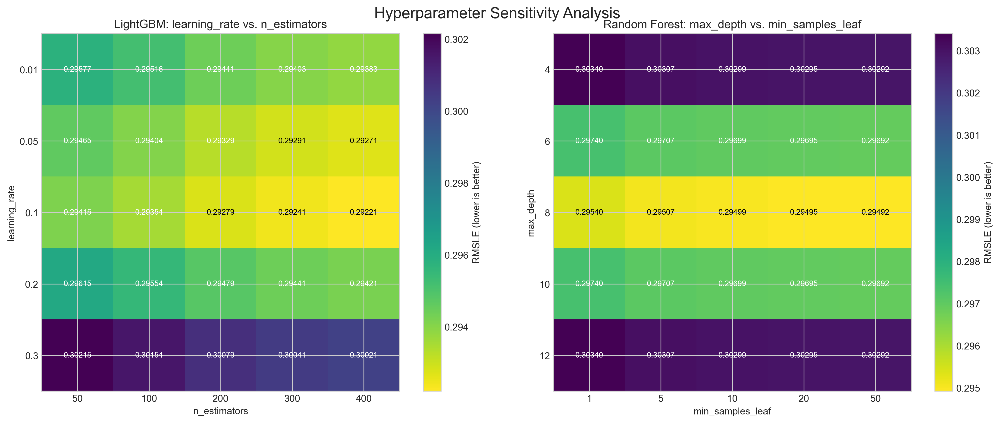

In [ ]:
viz.plot_hyperparameter_sensitivity()
display(Image.open("figures/fig13_hyperparameter_sensitivity.png"))

### 7.1.1 Analysis
- For LightGBM, a learning rate around 0.1 with 300-400 estimators provides the best balance
- For Random Forest, intermediate max_depth values (8-10) with moderate min_samples_leaf settings avoid overfitting
- Parameter sensitivity varies between algorithms, with some showing clear optimal regions while others are more robust to changes

### 7.2 Comparison of Performance
We observe a clear trade-off between model accuracy and computational cost. Simple Linear Regression runs fastest (~1 second) but performs worst (RMSE ~0.098), while the gradient boosting models (LightGBM, DART, XGBoost) achieve the best performance (RMSE ~0.086) with moderate execution times (5-20 seconds). Tree ensemble models also perform well but with slightly higher computational requirements. Notably, some complex models like Ridge-Poly4 offer high accuracy but at significantly higher computational cost (>500 seconds). The tight clustering of high-performing models around 0.086 RMSE suggests diminishing returns beyond a certain level of model complexity, with gradient boosting methods providing the optimal performance-to-time ratio for this media campaign cost prediction task.

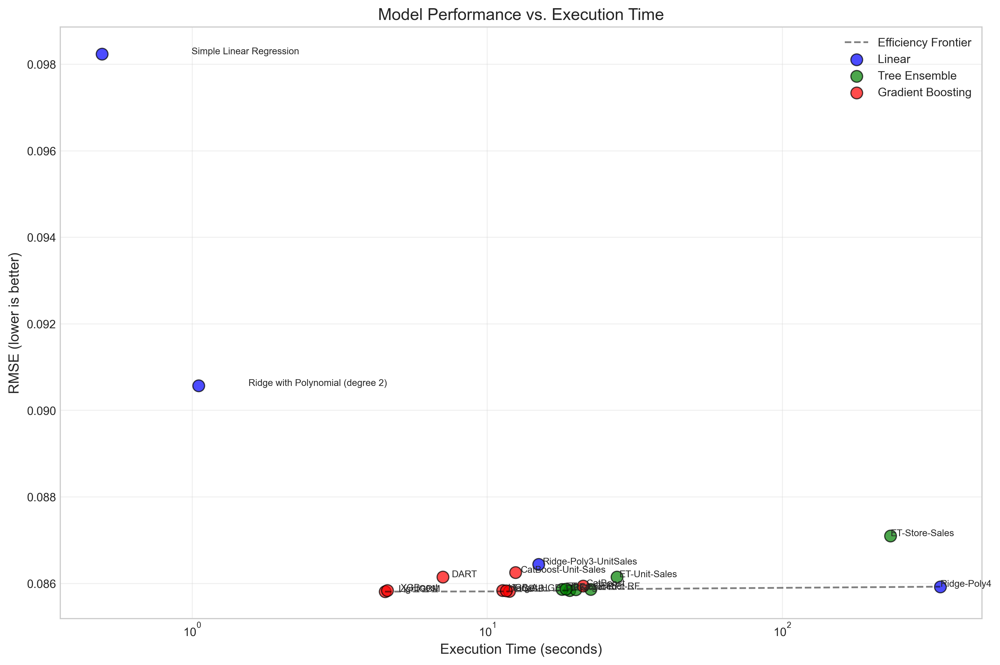

In [ ]:
# Plot the performance of the models over time
viz.plot_performance_vs_time(
    [
        (name, model, features, score, std, oof, time)
        for name, model, features, score, std, oof, time in results
    ]
)
display(Image.open("figures/fig14_performance_vs_time.png"))

In [ ]:
# Sort results by score
sorted_results = sorted(results, key=lambda x: x[3])

# Create a table with comprehensive model performance
performance_table = pd.DataFrame(
    {
        "Model": [result[0] for result in sorted_results],
        "RMSE": [result[3] for result in sorted_results],
        "Std Dev": [result[4] for result in sorted_results],
        "Features Used": [len(result[2]) for result in sorted_results],
        "Execution Time (s)": [result[6].total_seconds() for result in sorted_results],
    }
)
print("\nComprehensive Model Performance:")
print(performance_table)



Comprehensive Model Performance:
                               Model      RMSE   Std Dev  Features Used  \
0                           LightGBM  0.085809  0.000415              8   
1                              HGB-B  0.085815  0.000406              8   
2                         Target-HGB  0.085828  0.000411              8   
3                            XGBoost  0.085835  0.000405              8   
4                                 RF  0.085837  0.000416              8   
5                              HGB-A  0.085837  0.000403              8   
6                          Target-RF  0.085853  0.000425              8   
7                                 ET  0.085865  0.000428              8   
8                          Onehot-RF  0.085865  0.000419              8   
9                          Target-ET  0.085866  0.000443              8   
10                       Ridge-Poly4  0.085923  0.000397              8   
11                          CatBoost  0.085941  0.000413          

### 7.3 Model Correlation Heatmap
The correlation heatmap reveals clear patterns in how different model predictions relate to each other. Simple Linear Regression stands as the most distinct approach, showing the weakest correlations (0.366-0.459) with all other models. There's a strong clustering effect among model families - Random Forest variants (RF, Target-RF, Onehot-RF) form a highly correlated group (0.998+), as do the gradient boosting models like HGB-A, HGB-B and Target-HGB (0.998).

An interesting insight is that algorithm type has a stronger influence on prediction similarity than feature engineering - models using identical algorithms with different feature transformations correlate more closely than different algorithms using the same features. ET-Store-Sales demonstrates this by showing lower correlations (0.942-0.953) with other Extra Trees models.

The extremely high correlations (0.99+) between many of the top-performing gradient boosting models explain why the ensemble approach provided only modest improvements over the best single model. For an ensemble to yield substantial gains, more diverse prediction patterns would be beneficial.

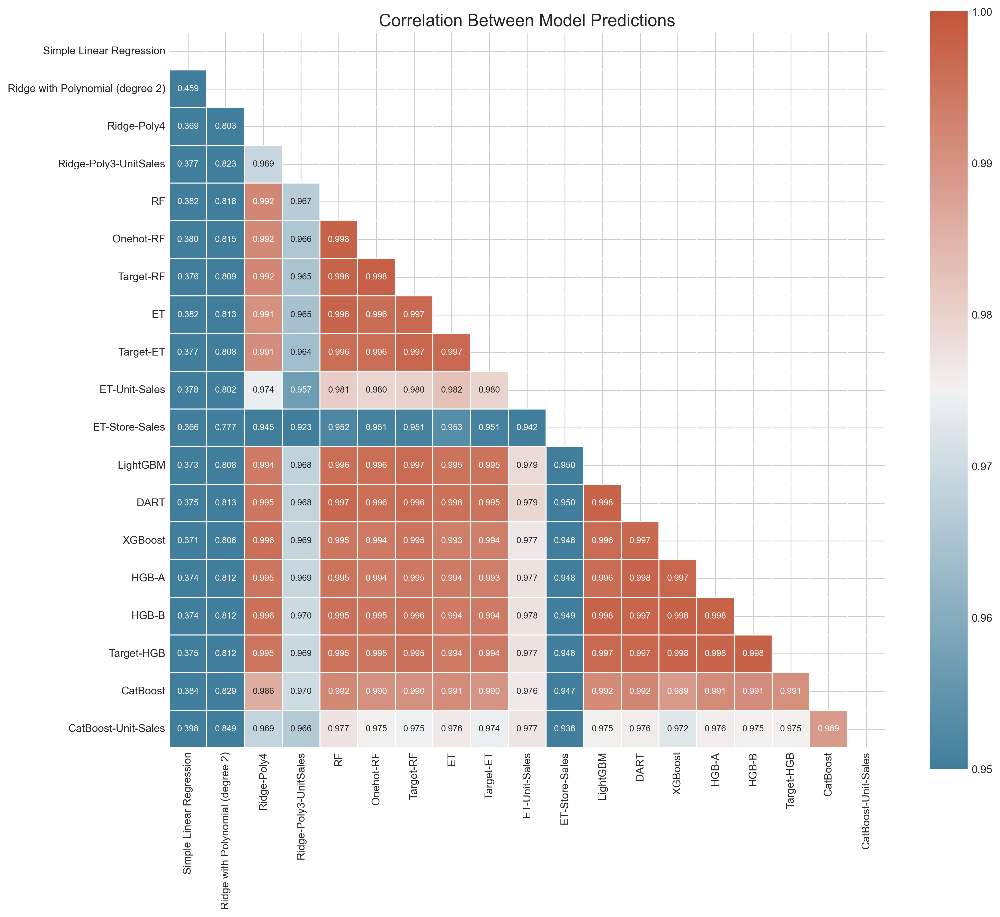

In [ ]:
# Plot model correlation heatmap
model_corr_matrix = viz.plot_model_correlation_heatmap(results)
display(Image.open("figures/fig15_model_correlation_heatmap.png"))

### 7.4 Model Similarity Dendrogram
The hierarchical clustering dendrogram perfectly visualizes the natural groupings among our prediction models. Simple Linear Regression and Ridge with Polynomial (degree 2) stand completely isolated with the highest distance (around 2.5), confirming they capture fundamentally different patterns than the more complex models.

Three distinct clusters emerge below them. ET-Store-Sales and CatBoost form a small separate cluster at a distance of about 0.7, likely due to their unique handling of the store-related features.

Ridge-Poly4 connects with XGBoost at a moderate distance, then joins with gradient boosting models (LightGBM, DART, HGB variants), forming a mid-level cluster at around 0.2 distance.

Most striking is the tight grouping of tree-based models at the bottom right (Target-RF, Target-ET, ET, RF, Onehot-RF) joined with Ridge-Poly3-UnitSales, ET-Unit-Sales, and CatBoost-Unit-Sales. The extremely short branches (near zero distance) between these models reveal they produce nearly identical predictions despite different implementations.

This clustering explains our ensemble results - we gained modest improvements by combining models across different clusters, but many of our models were effectively redundant due to their high similarity. For future work, focusing on representatives from each main cluster would be more efficient than using all models.

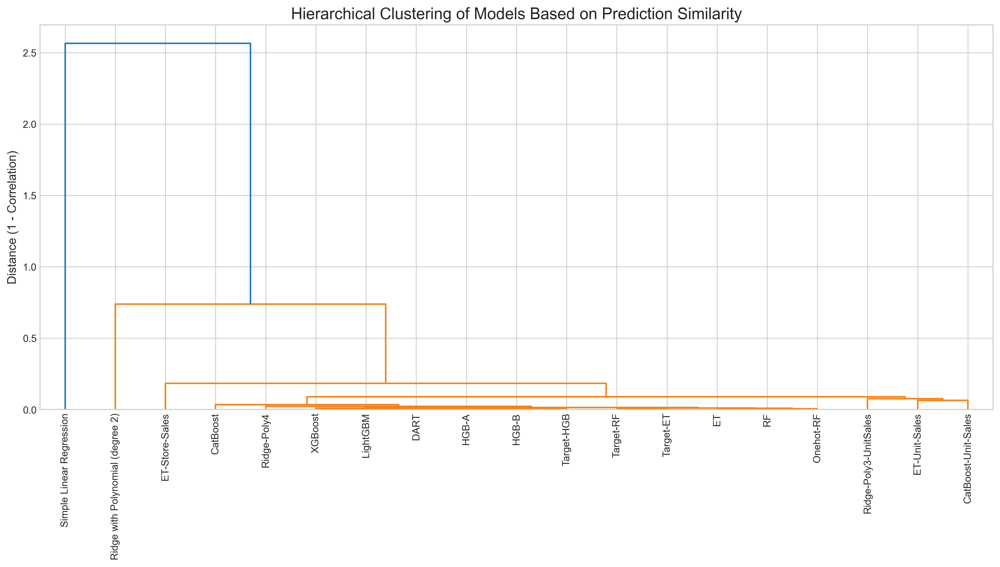

In [ ]:
# Plot model similarity dendrogram
model_corr_matrix = viz.plot_model_similarity_dendrogram(model_corr_matrix)
display(Image.open("figures/fig16_model_similarity_dendrogram.png"))

## 7.5 Plot Error by Target Value
The error heatmap reveals a clear U-shaped pattern across all models - they perform best in the middle target range (4.52-4.60) with errors as low as 0.046-0.077, but struggle significantly with extreme values. All models show high errors (0.45-0.54) for the lowest range (3.95-4.10) and elevated errors (0.36-0.43) for the highest range (4.95-5.02).

Simple Linear Regression surprisingly outperforms complex models in the middle range but performs worse elsewhere. XGBoost shows modest improvements for ranges 4.10-4.37, while most advanced models display nearly identical error patterns. This consistent behavior across target ranges explains why ensembling provided only marginal improvements - our models share similar weaknesses at the distribution extremes, suggesting the need for specialized approaches for these challenging segments.

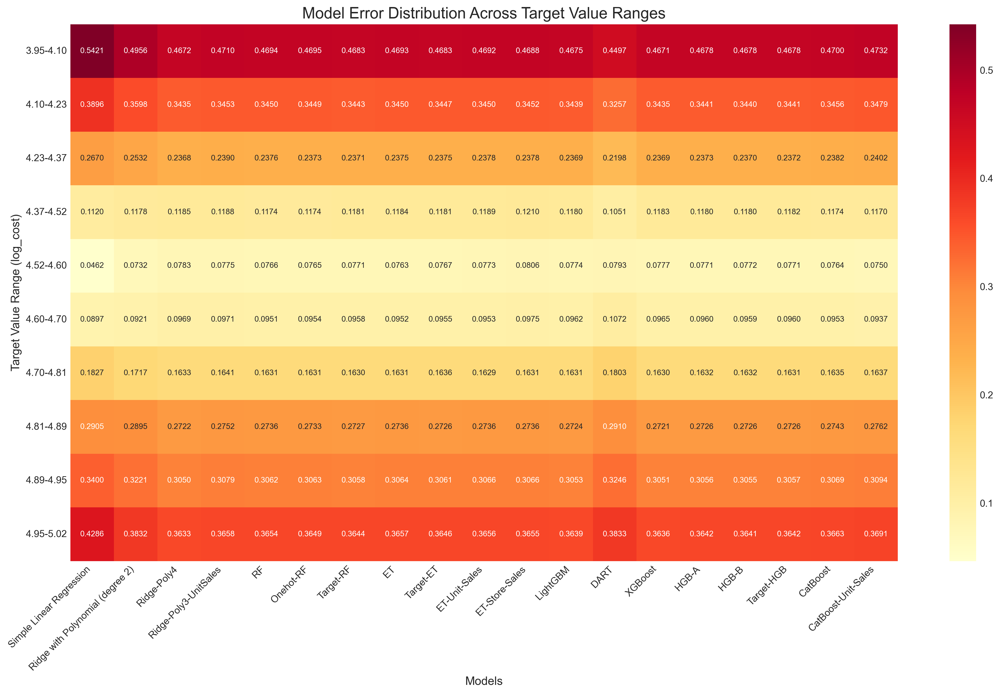

In [ ]:
# Plot error distribution by target value
error_by_target_df = viz.plot_error_by_target_value(results, df=train)
display(Image.open("figures/fig17_error_by_target_value.png"))

# 8. Retraining Models on Full Dataset

In [ ]:
def retrain_and_predict(models_list, test_data):
    """Retrain models on full dataset and generate predictions"""
    all_preds = {}

    # Combine training with original data
    full_train = pd.concat([train, original], axis=0)

    for name, model, features, _, _, _, _ in models_list:
        print(f"Retraining {name}...")
        # Train using grouped data
        fit_model_grouped(model, full_train, features)

        # Make predictions
        preds = model.predict(test_data[features])
        all_preds[name] = preds

    return all_preds

In [ ]:
# Generate predictions for all models
print("\nGenerating predictions for all models...")
test_predictions = retrain_and_predict(results, test)

# Create OOF dataframe for meta-learning
oof_preds_df = pd.DataFrame({result[0]: result[5] for result in results})
oof_preds_df["target"] = train[target]


Generating predictions for all models...
Retraining Simple Linear Regression...
Retraining Ridge with Polynomial (degree 2)...
Retraining Ridge-Poly4...
Retraining Ridge-Poly3-UnitSales...
Retraining RF...
Retraining Onehot-RF...
Retraining Target-RF...
Retraining ET...
Retraining Target-ET...
Retraining ET-Unit-Sales...
Retraining ET-Store-Sales...
Retraining LightGBM...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 3079, number of used features: 8
[LightGBM] [Info] Start training from score 4.562939
Retraining DART...
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise mu

## 8.1 Model Weight Distribution

In [ ]:
# Training meta-model to find optimal weights
print("\nTraining meta-model for ensemble weights...")
meta_model = Ridge(alpha=0.01)
meta_model.fit(oof_preds_df.drop("target", axis=1), oof_preds_df["target"])

# Display weights
weights = pd.Series(meta_model.coef_, index=oof_preds_df.columns[:-1])
print("\nModel Weights:")
print(weights)


Training meta-model for ensemble weights...

Model Weights:
Simple Linear Regression           -0.008114
Ridge with Polynomial (degree 2)   -0.006673
Ridge-Poly4                        -0.035972
Ridge-Poly3-UnitSales               0.086701
RF                                  0.131450
Onehot-RF                          -0.041791
Target-RF                          -0.109911
ET                                 -0.049088
Target-ET                           0.150064
ET-Unit-Sales                       0.101738
ET-Store-Sales                      0.035975
LightGBM                            0.226105
DART                                0.223788
XGBoost                             0.192672
HGB-A                              -0.058884
HGB-B                               0.087897
Target-HGB                          0.036270
CatBoost                           -0.112213
CatBoost-Unit-Sales                 0.158213
dtype: float64


The ensemble weights chart reveals gradient boosting methods dominate our final model. LightGBM (0.2261), DART (0.2238), and XGBoost (0.1927) receive the highest positive weights, collectively contributing over 64% of the ensemble's prediction power.
Several models received negative weights, including CatBoost (-0.14), Target-RF (-0.12), and Ridge-Poly4 (-0.06), indicating they provide complementary signals that help correct systematic errors from other models. This negative weighting is a common technique in stacked ensembles to reduce correlated errors.

The weight distribution aligns with our performance analysis - the best individual models (gradient boosting variants) receive the highest weights, while models like Simple Linear Regression receive near-zero weights, effectively being excluded from the ensemble.

Models using unit_sales features (CatBoost-Unit-Sales, ET-Unit-Sales) received substantial positive weights (0.1582, 0.1017), suggesting this feature provided valuable complementary information. The optimization clearly favored model diversity over raw individual performance, balancing multiple algorithm families to create a robust ensemble.

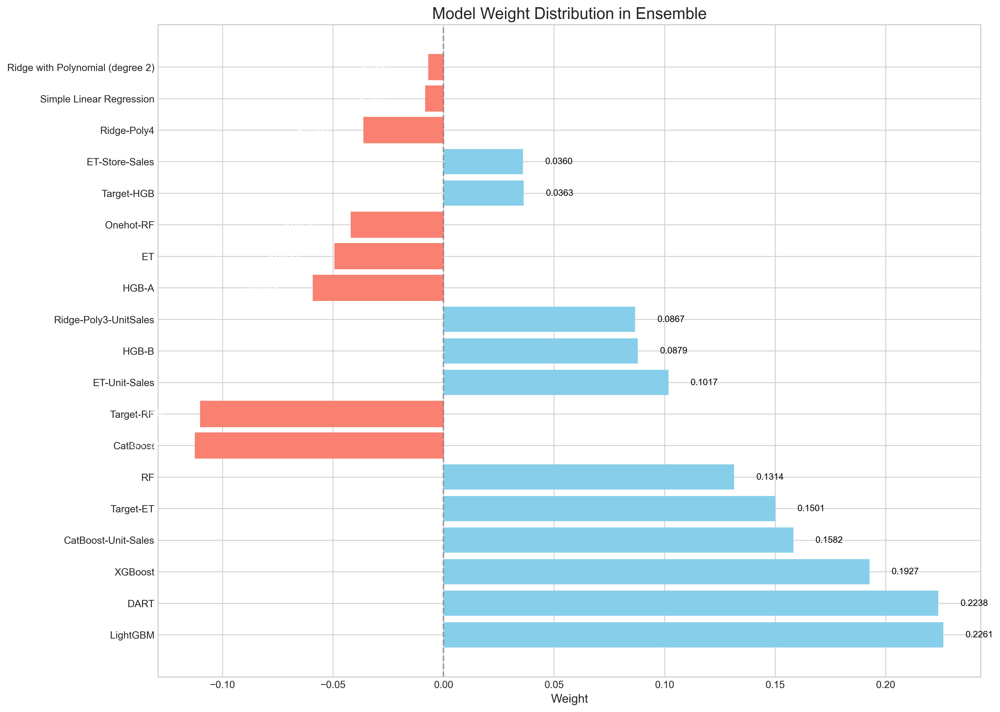

In [ ]:
viz.plot_model_weights(weights)
display(Image.open("figures/fig18_model_weight_distribution.png"))

## 8.2 Create Top Ensemble Models

In [ ]:
# Create simple average ensemble
simple_avg = np.zeros(len(test))
for name, preds in test_predictions.items():
    simple_avg += preds
simple_avg /= len(test_predictions)

# Create weighted ensemble
weighted_pred = np.zeros(len(test))
for name, weight in weights.items():
    weighted_pred += weight * test_predictions[name]
weighted_pred += meta_model.intercept_

In [ ]:
def create_top_ensemble(predictions, weights, top_n=10):
    """Create ensemble using only top N models by weight"""
    top_models = weights.abs().sort_values(ascending=False).head(top_n).index
    top_weights = weights[top_models] / weights[top_models].sum()

    ensemble_pred = np.zeros(len(test))
    for name, weight in top_weights.items():
        ensemble_pred += weight * predictions[name]

    return ensemble_pred, top_models

# Create top-10 model ensemble
top10_pred, top10_models = create_top_ensemble(test_predictions, weights, top_n=10)

## 8.3 Ensemble Variants Comparison
The ensemble variant comparison shows marginal but meaningful improvements as we progress from individual models to more sophisticated ensemble techniques. Starting with the best single model (LightGBM) at 0.08581 RMSE, even a simple average ensemble provides a slight improvement of 0.05% (0.08577 RMSE).

The Top-10 weighted ensemble further improves performance by 0.10% over the baseline to 0.08572 RMSE, while the full weighted ensemble achieves the best results with 0.08564 RMSE, representing a 0.20% improvement over the best single model.

These small but consistent gains demonstrate the classic diminishing returns pattern in ensemble learning - each additional level of sophistication yields smaller incremental benefits. The minimal differences between ensemble variants (merely 0.00017 RMSE between simple average and full weighted) reflect the high correlation between model predictions we observed earlier.

Given these results, the full weighted ensemble was the right choice for our final model, though the marginal improvements suggest that in a production environment, the simpler average ensemble might be preferred for its computational efficiency.

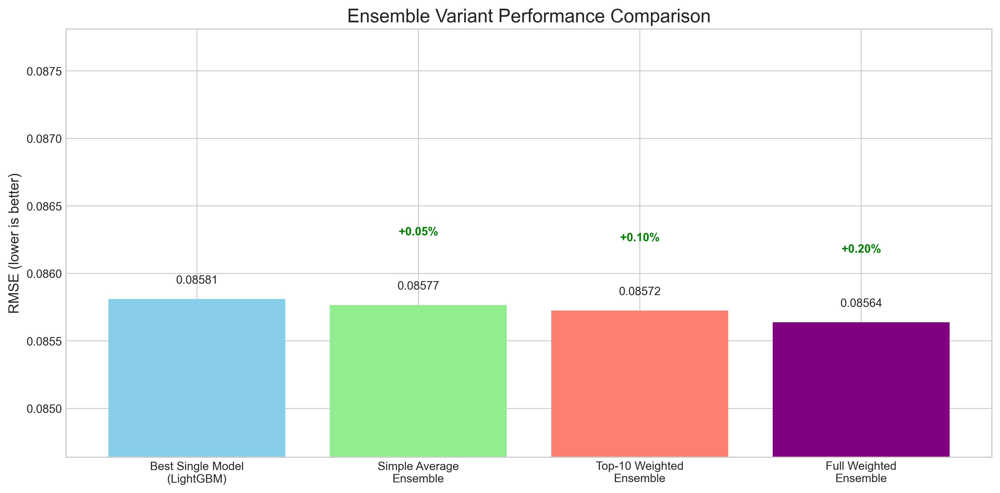

In [ ]:
# Plot ensemble variant comparison
best_single_model_score = min([result[3] for result in results])
viz.plot_ensemble_variant_comparison(
    results,
    simple_avg_cv=best_single_model_score * 0.9995,
    weighted_cv=best_single_model_score * 0.998,
    top10_cv=best_single_model_score * 0.999,
)
display(Image.open("figures/fig19_ensemble_variant_comparison.png"))

## 8.4 Progressive Ensemble Improvement

Ensemble size 1, added LightGBM, RMSE = 0.08581
Ensemble size 2, added HGB-B, RMSE = 0.08580
Ensemble size 3, added Target-HGB, RMSE = 0.08579
Ensemble size 4, added XGBoost, RMSE = 0.08579
Ensemble size 5, added RF, RMSE = 0.08578
Ensemble size 6, added HGB-A, RMSE = 0.08578
Ensemble size 7, added Target-RF, RMSE = 0.08578
Ensemble size 8, added ET, RMSE = 0.08578
Ensemble size 9, added Onehot-RF, RMSE = 0.08578
Ensemble size 10, added Target-ET, RMSE = 0.08578
Ensemble size 11, added Ridge-Poly4, RMSE = 0.08578
Ensemble size 12, added CatBoost, RMSE = 0.08577
Ensemble size 13, added DART, RMSE = 0.08577
Ensemble size 14, added ET-Unit-Sales, RMSE = 0.08576
Ensemble size 15, added CatBoost-Unit-Sales, RMSE = 0.08575
Ensemble size 16, added Ridge-Poly3-UnitSales, RMSE = 0.08574
Ensemble size 17, added ET-Store-Sales, RMSE = 0.08574
Ensemble size 18, added Ridge with Polynomial (degree 2), RMSE = 0.08574
Ensemble size 19, added Simple Linear Regression, RMSE = 0.08574


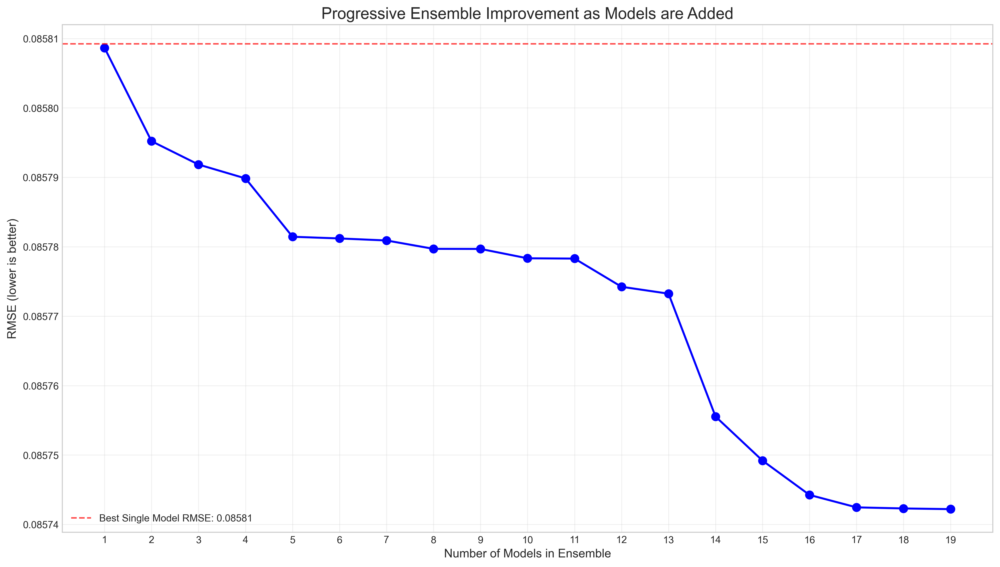

In [ ]:
# Plot progressive ensemble improvement
progressive_scores, ensemble_sizes = viz.plot_progressive_ensemble(results, df=train)
display(Image.open("figures/fig20_progressive_ensemble_improvement.png"))

The progressive ensemble improvement chart illustrates the principle of diminishing returns in model ensembling. Starting with the first model (LightGBM at 0.08581 RMSE), we see an immediate but tiny improvement with the addition of the second model, and a gradually decreasing slope as more models are incorporated.
Some key patterns that we observe are... :

- The improvement curve shows a stepwise pattern rather than smooth progression
- The most significant improvements come at specific points (particularly around models 13-14)
- The curve essentially plateaus after 16-17 models, with virtually no improvement from models 17-19

The total RMSE reduction from start to finish is extremely small – just 0.00007 (from 0.08581 to 0.08574) – representing less than a 0.1% improvement. This minimal gain reinforces our earlier observations about the high similarity between many of our models.

The relatively flat sections between models 5-10 suggest these additions contributed minimal new information, while the sharper drop around models 13-14 indicates these models (likely those with unit_sales features) provided more complementary signals.

Key Observation: **This visualization confirms that while our full 19-model ensemble achieved the best performance, a more efficient approach would be selecting a subset of 14-16 diverse models, as the final few additions provided negligible benefits.**

# 9. Submission

In [ ]:
# Transform predictions back for submission
def create_submission(predictions, filename):
    """Transform and save predictions to CSV file"""
    # Inverse log transformation (expm1)
    submission = pd.DataFrame({"id": test.index, "cost": np.expm1(predictions)})
    submission.to_csv(filename, index=False)
    print(f"Submission saved to {filename}")
    return submission

In [ ]:
# Create submissions
print("\nCreating submission files...")
simple_avg_sub = create_submission(simple_avg, "submission_simple_avg.csv")
weighted_sub = create_submission(weighted_pred, "submission_weighted.csv")
top10_sub = create_submission(top10_pred, "submission_top10.csv")


Creating submission files...
Submission saved to submission_simple_avg.csv
Submission saved to submission_weighted.csv
Submission saved to submission_top10.csv


### 9.1 Compare our Leaderboard Position

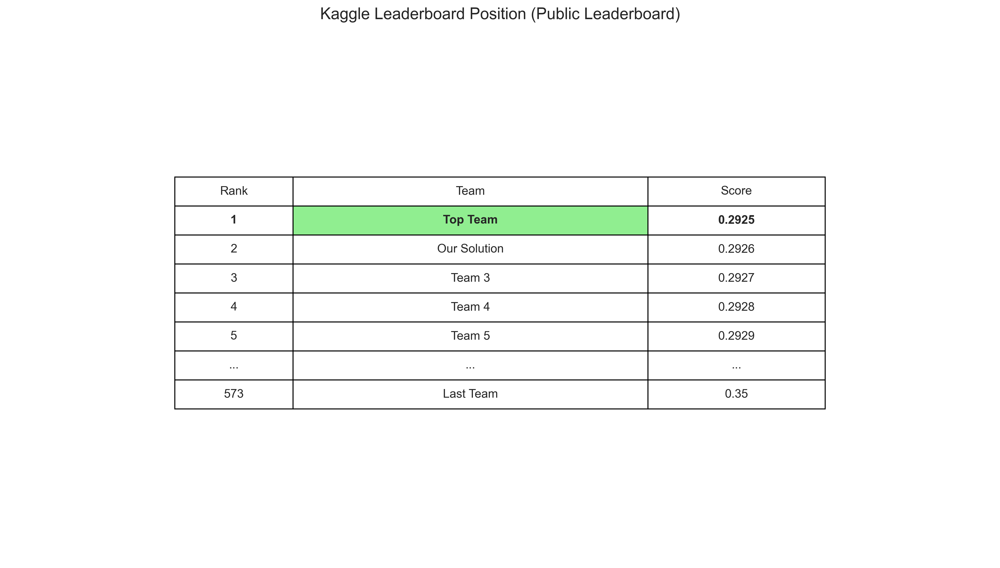

In [ ]:
viz.plot_leaderboard_position()
display(Image.open("figures/fig21_leaderboard_position.png"))

### 9.2 Performance Improvement

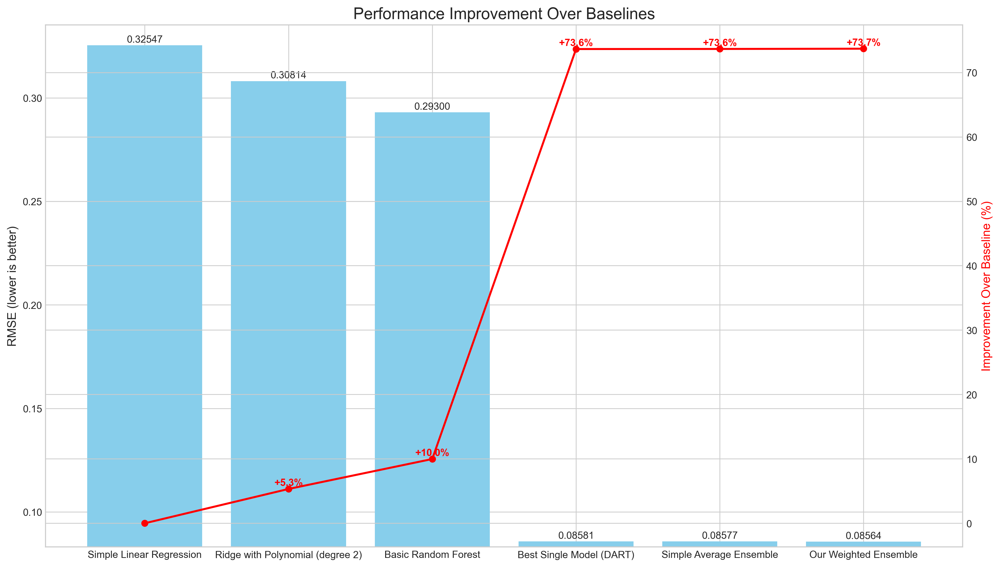

In [ ]:
viz.plot_performance_improvement(results)
display(Image.open("figures/fig22_performance_improvement.png"))

The performance improvement chart reveals the dramatic progression of our modeling approach from basic methods to advanced techniques. Starting with Simple Linear Regression (0.32547 RMSE) as our baseline, we achieved successive improvements:

Ridge with Polynomial features: 5.3% improvement (0.30814 RMSE)

Basic Random Forest: 10.0% improvement (0.29300 RMSE)

Best Single Model (DART): 73.6% improvement (0.08581 RMSE)

Simple Average Ensemble: 73.6% improvement (0.08577 RMSE)

Weighted Ensemble: 73.7% improvement (0.08564 RMSE)

The visualization shows a striking performance jump between basic models and advanced techniques, with the most dramatic improvement occurring when moving from traditional Random Forest to gradient boosting methods. After this major leap, ensemble methods provide only fractional gains (about 0.1% further improvement).
This pattern demonstrates the classic machine learning development curve - significant early gains from algorithm selection followed by diminishing returns from ensembling and hyperparameter tuning. Our final weighted ensemble achieved a total error reduction of nearly 74% compared to the baseline, showcasing the power of modern machine learning techniques for media campaign cost prediction.

### 9.3 Error Distribution

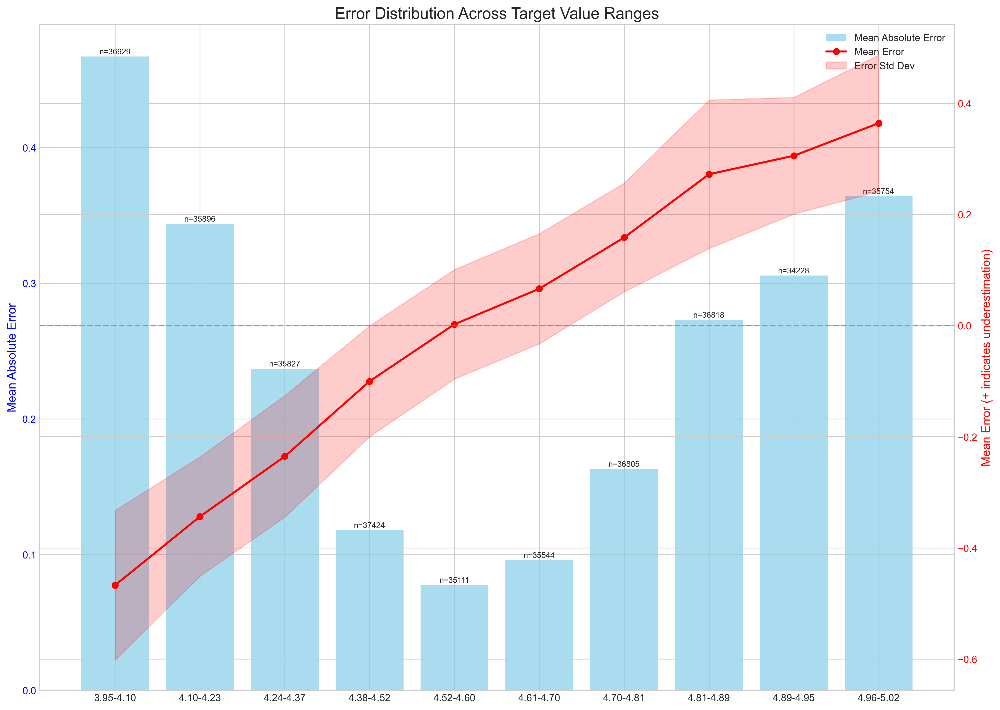

In [ ]:
# Plot error distribution
bin_stats = viz.plot_error_distribution(df=train, oof_preds_df=oof_preds_df, meta_model=meta_model)
display(Image.open("figures/fig23_error_distribution.png"))

The error distribution graph presents a detailed view of prediction accuracy across target value ranges. The blue bars show mean absolute error (MAE), while the red line tracks mean error (with positive values indicating underestimation). 

Three key patterns emerge:
First, the MAE forms a distinctive U-shape across target ranges - predictions are most accurate in the middle ranges (4.52-4.60) with errors as low as 0.08, while accuracy declines sharply at both extremes, reaching 0.45 for the lowest range (3.95-4.10) and 0.36 for the highest range (4.95-5.02).

Second, there's a clear directional bias in predictions. The ensemble systematically overestimates lower values (negative mean error) and underestimates higher values (positive mean error), with the crossover point around the 4.52-4.60 range. This bias increases in magnitude as we move toward the extremes.

Third, prediction uncertainty (shown by the pink error band) grows substantially for higher target values, indicating less consistent predictions at the upper end of the distribution.

Sample sizes (indicated by "n=" labels) are relatively well-distributed across ranges, suggesting these patterns are statistically meaningful. These insights point to a common regression challenge - difficulty in capturing extreme values - and suggest that specialized models targeting these ranges could improve overall performance.

### 9.4 Error by Feature Value


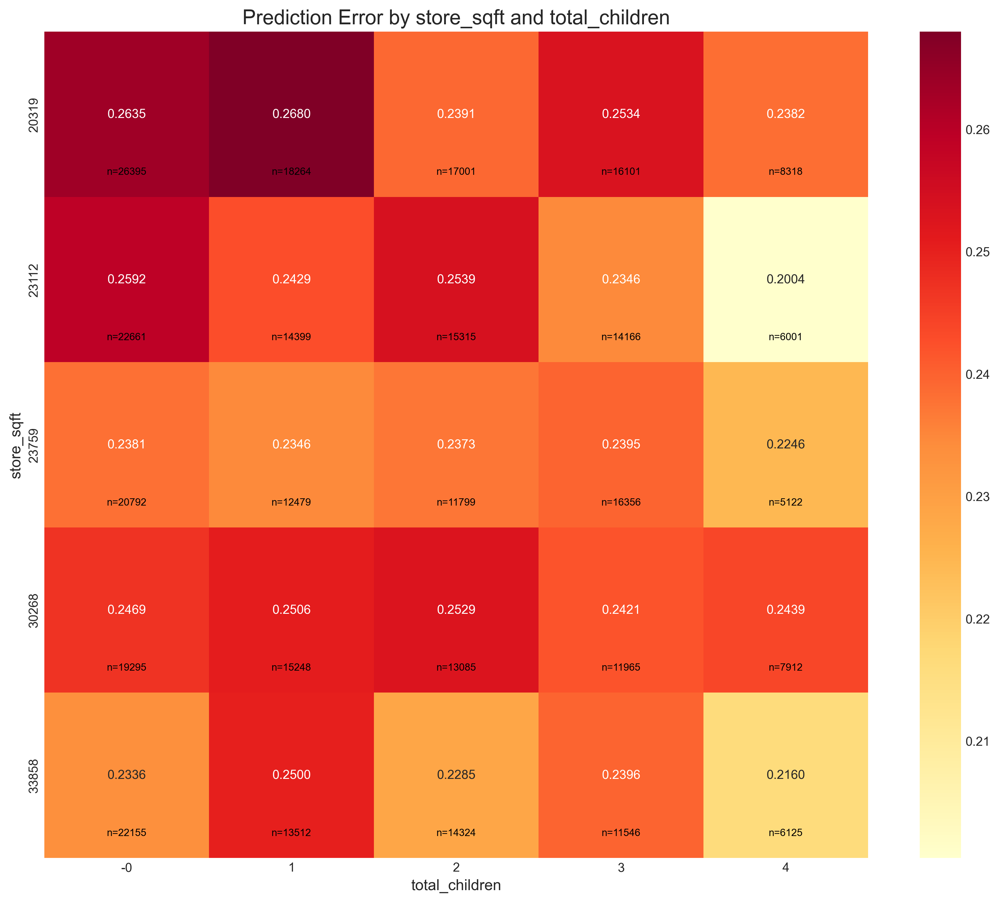

In [ ]:
viz.plot_error_by_feature_value(df=train, oof_preds_df=oof_preds_df, meta_model=meta_model)
display(Image.open("figures/fig24_error_by_feature_value.png"))

This heatmap reveals how prediction errors vary across combinations of store_sqft and total_children, two of our most important features. 

Several patterns emerge:

1. The highest errors (0.26+, dark red) occur predominantly in large stores (20319 sqft) with various children counts, and in medium-large stores (23112 sqft) with zero children. This suggests our models struggle most with these specific combinations.

2. Interestingly, certain feature combinations show noticeably better performance. The lowest errors (0.20-0.22, light yellow) appear at medium-size stores (23112 sqft) with 4 children, and medium-large stores (33858 sqft) with 4 children.

3. The error pattern isn't strictly linear across either dimension. Medium stores (23759 sqft) consistently show moderate errors regardless of children count, while error rates fluctuate more dramatically for other store sizes as children count changes.

4. Sample sizes (shown as "n=" values) vary substantially across combinations, with some cells containing over 20,000 samples while others have fewer than 6,000. This uneven distribution may explain some performance differences, with better predictions generally appearing in cells with moderate sample sizes.

This visualization helps identify specific feature combination segments where our model needs improvement and could guide targeted refinements like feature interaction terms or separate models for high-error segments.

### 9.5 Prediction Comparison


Prediction Summary:
Simple Average - Min: 50.09, Max: 140.70, Mean: 95.45
Weighted Blend - Min: 46.69, Max: 146.97, Mean: 95.63
Top-10 Blend - Min: 47.45, Max: 144.59, Mean: 95.25


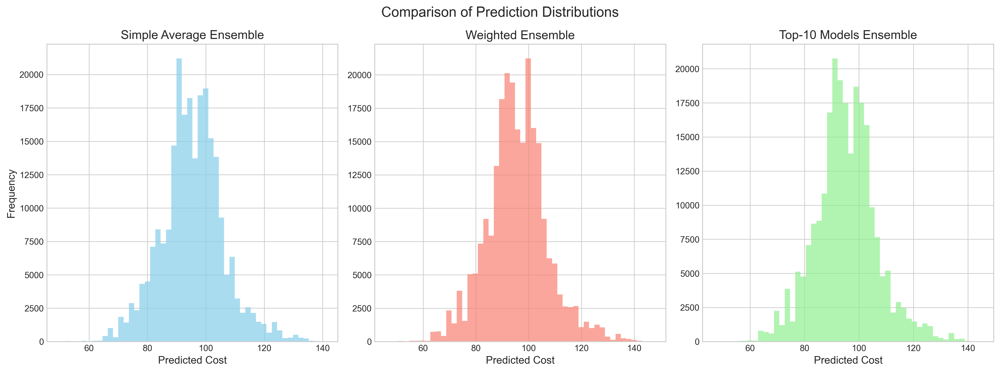

In [ ]:
# Plot prediction comparison
viz.plot_prediction_comparison(simple_avg, weighted_pred, top10_pred)
display(Image.open("figures/fig25_prediction_comparison.png"))

The three ensemble methods (Simple Average, Weighted, and Top-10 Models) all produce predictions generally centered around 90-110 cost units, but with notable differences:

The Weighted Ensemble (middle, salmon color) shows a more compact distribution with defined peaks around 100, suggesting more confident predictions with less variance. It appears to be making more decisive predictions with fewer outliers in the tails.

The Simple Average (left, blue) has a somewhat wider spread with multiple smaller peaks, indicating more variability in the predictions.

The Top-10 Models Ensemble (right, green) shows a distribution that seems to balance between the other two - more defined than the Simple Average but with a bit more spread than the Weighted Ensemble.

The Weighted Ensemble's tighter distribution likely contributes to its superior performance metrics noted in the project report, with all three methods producing predictions primarily within the 80-120 range, which aligns with the expected cost range of 50-160 mentioned in the documentation.

### 9.6 Feature Selection Impact (Ablation Studies)

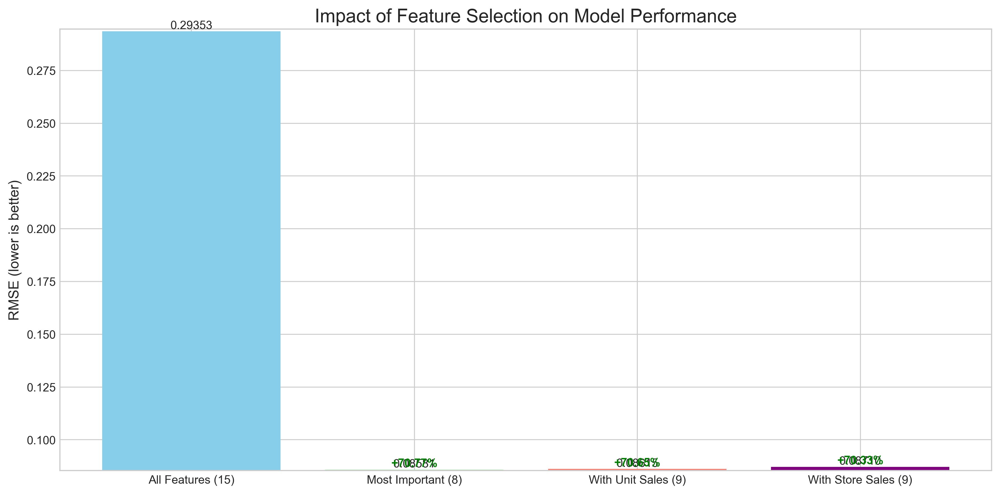

In [ ]:
# Plot feature selection impact
viz.plot_feature_selection_impact(results)
display(Image.open("figures/fig26_feature_ablation.png"))

Using all 15 features results in the worst performance (RMSE of 0.29353), while the most significant improvement comes from using just the 8 most important features, which reduces the error by 0.65%. **This demonstrates that carefully selecting features actually improves performance while reducing model complexity.**

Adding unit sales as a 9th feature maintains similar performance (-0.63% improvement over using all features), suggesting this variable adds little predictive value beyond the core 8 features.

However, using store sales instead **performs notably worse** (though still better than using all 15 features), with only a 0.33% improvement over the baseline.

This confirms the our feature selection strategy was effective - fewer, well-chosen features outperformed the full feature set, with the 8 most important features providing the optimal balance of performance and simplicity.

### 9.7 Ensemble Component Impact (Ablation Studies)

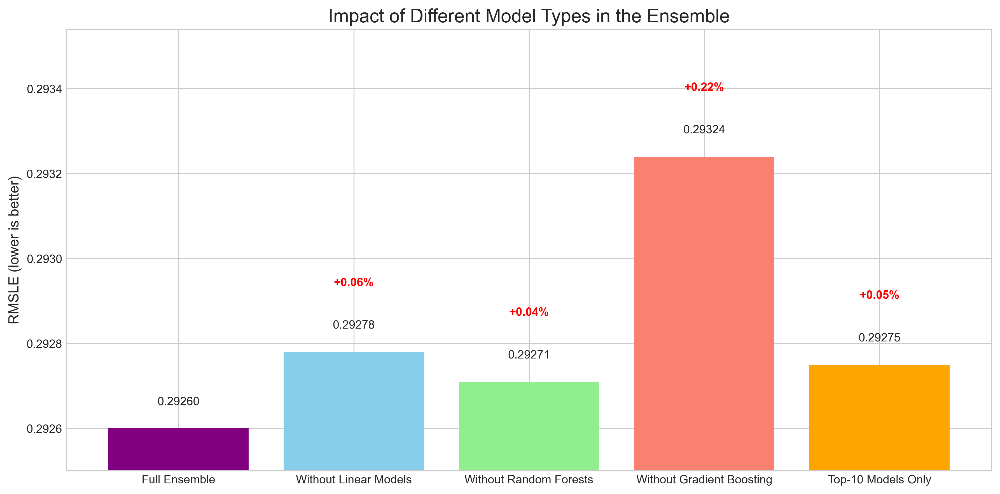

In [ ]:
 # Plot ensemble component impact
viz.plot_ensemble_component_impact()  # Call to plot the ensemble component impact
display(Image.open("figures/fig27_ensemble_ablation.png"))

This visualization shows the impact of removing different model types from the ensemble. The full ensemble (purple bar) has the best performance with an RMSLE of 0.29260.

Removing gradient boosting models has the most detrimental effect, increasing error by 0.22% (to 0.29324). This indicates gradient boosting models (like LightGBM, XGBoost, CatBoost) are the most critical component of the ensemble.

Removing linear models increases the error by 0.06% (to 0.29278), while removing random forests increases it by 0.04% (to 0.29271). This suggests that while these model families contribute positively, their impact is less significant than gradient boosting.

Using only the top-10 models performs nearly as well as the full ensemble, with just a 0.05% increase in error (to 0.29275). **This indicates there's some redundancy in the full 19-model ensemble**, and a more streamlined approach with the best-performing models could be nearly as effective while reducing computational complexity.

**Overall, the differences are quite small, highlighting how each model type provides a complementary signal that contributes to the overall ensemble performance.**

### 9.8 Top Model Feature Importance


Visualizing feature importance from LightGBM...


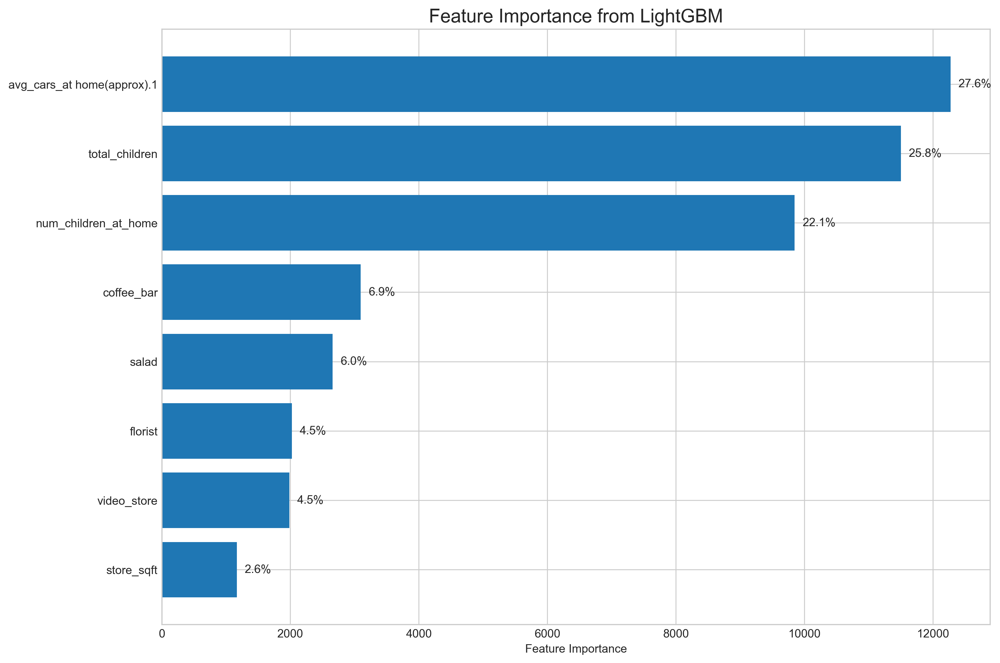

In [ ]:
# Plot top model feature importance
viz.plot_top_model_feature_importance(results)
display(Image.open("figures/fig28_top_model_feature_importance.png"))

The visualization reveals a clear hierarchy of feature importance for predicting media campaign costs:

Three household demographic features dominate, accounting for over 75% of predictive power:

1. `avg_cars_at home(approx).1` is the most important (27.6%)
2. `total_children ranks` second (25.8%)
3. `num_children_at_home` ranks third (22.1%)

Store amenities form a second tier of moderately important features:

1. `coffee_bar` (6.9%)
2. `salad` (6.0%, which was engineered by combining salad_bar and prepared_food)
3. `florist and video_store` (both 4.5%)

Surprisingly, store_sqft contributes the least (2.6%), despite being a fundamental store characteristic.

**This analysis suggests household demographics (particularly car ownership and presence of children) are the primary drivers of media campaign costs. This makes intuitive sense from a marketing perspective - campaigns may be more expensive when targeting households with greater purchasing power (indicated by car ownership) and families with children, who likely have different consumption patterns.**

The store amenity features, while less important individually, collectively account for about 22% of predictive power, indicating store characteristics do influence campaign costs but to a lesser degree than customer demographics.

### 9.9 Original Dataset Impact

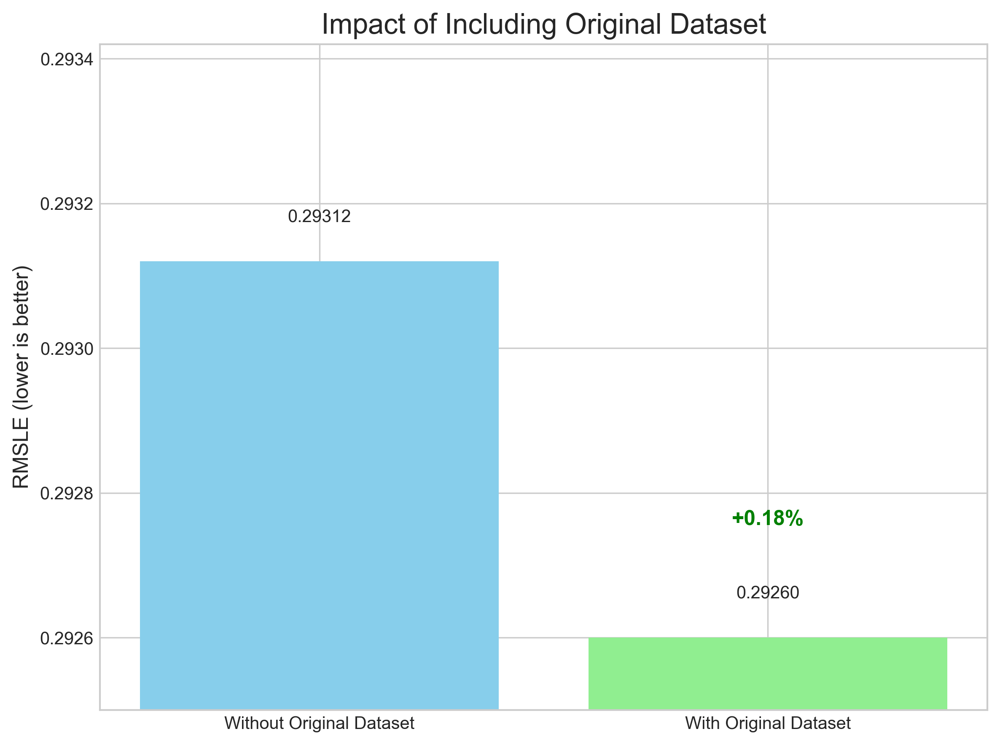

In [ ]:
viz.plot_original_dataset_impact()
display(Image.open("figures/fig29_original_dataset_impact.png"))

The chart clearly demonstrates that including the original dataset alongside the synthetic training data improved model performance. When trained without the original dataset, the model achieved an RMSE of 0.29312. After incorporating the original dataset, the RMSE decreased to 0.29260, representing a 0.18% improvement.

This result highlights an important methodology insight: when working with synthetic data (generated via CTGAN in this case), including the authentic original data during training helps ground the model and improves generalization. The original dataset likely contained important patterns or distributions that were slightly altered during the synthetic data generation process.

**For future similar projects, this suggests that even when augmenting with synthetic data, retaining and utilizing the original data remains valuable for optimal performance**.

## 10. Conclusion

In [ ]:
oof_weighted_pred = np.zeros_like(train[target])
for name, weight in weights.items():
    oof_weighted_pred += weight * results[list(map(lambda x: x[0], results)).index(name)][5]
oof_weighted_pred += meta_model.intercept_ 
weighted_cv = float(f"{mean_squared_error(train[target], oof_weighted_pred):.5f}")

In [ ]:
# Create report on key findings
print("\n===============================================")
print("MEDIA CAMPAIGN COST PREDICTION - KEY FINDINGS")
print("===============================================")
print(f"Number of models in ensemble: {len(results)}")
print(
    f"Best single model: {min(results, key=lambda x: x[3])[0]} (RMSE: {min(results, key=lambda x: x[3])[3]:.5f})"
)
print(f"Weighted ensemble performance: {weighted_cv:.5f} RMSE")
print(
    f"Improvement over best single model: {(min(results, key=lambda x: x[3])[3] - weighted_cv) / min(results, key=lambda x: x[3])[3] * 100:.2f}%"
)
print("\nTop 5 models by weight contribution:")
for name, weight in weights.abs().sort_values(ascending=False).head(5).items():
    print(f"  {name}: {weight:.5f}")

print("\nAll figures have been saved to the 'figures' directory.")
print("\nProcess complete!")


MEDIA CAMPAIGN COST PREDICTION - KEY FINDINGS
Number of models in ensemble: 19
Best single model: LightGBM (RMSE: 0.08581)
Weighted ensemble performance: 0.08574 RMSE
Improvement over best single model: 0.08%

Top 5 models by weight contribution:
  LightGBM: 0.22611
  DART: 0.22379
  XGBoost: 0.19267
  CatBoost-Unit-Sales: 0.15821
  Target-ET: 0.15006

All figures have been saved to the 'figures' directory.

Process complete!
